This notebook accompaigns our paper *Style transfer with variational autoencoders is a promising approach to RNA-Seq data harmonization and analysis* https://doi.org/10.1101/791962  
The paper was submitted to Bioinformatics journal and currently was significantly revised after reviewer's critical comments and suggestions. Soon it will also be updated on bioRxiv.  
This notebook describes our experiments with autoencoder models applied to single cell RNA-Seq GSE96583 dataset since this it contains several cell types and two biological conditions and thus can be used for bilogical validation of our approach. If you have critical comments/suggestions &mdash; you are always welcome! We are highly interested in any new ideas and are always open for collaboration.
  

In [2070]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt # библиотека для построения графиков
import seaborn as sns # библиотека для построения графиков

import anndata, logging, scipy.stats, itertools, gc
import scanpy as sc

from IPython.display import display, HTML, Image

#%matplotlib inline 

In [2073]:
#gc.collect()

In [410]:
## https://scanpy-tutorials.readthedocs.io/en/latest/pbmc3k.html
## https://scanpy.readthedocs.io/en/stable/usage-principles.html
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=150, figsize=[8, 8])

scanpy==1.4.5.1 anndata==0.7.1 umap==0.3.10 numpy==1.16.4 scipy==1.4.1 pandas==1.0.0 scikit-learn==0.22.1 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [ ]:
## databases:
## ftp://ftp.ebi.ac.uk/pub/databases/

In [4]:
np.set_printoptions(precision=3)

In [855]:
#sns.set(font = 'Noto Mono')
sns.set(style = 'whitegrid', font = 'Bitstream Vera Sans Mono')#'DejaVu Sans Mono')

In [852]:
import matplotlib as mpl
font_paths = mpl.font_manager.findSystemFonts()
font_objects = mpl.font_manager.createFontList(font_paths)
font_names = [f.name for f in font_objects]
# print (font_names)

### 1. Read the original data from scGen paper

In [1549]:
train = sc.read_h5ad("./scGen_IFNb_train.h5ad")
validation = sc.read_h5ad("./scGen_IFNb_validation.h5ad")

train.shape, validation.shape

((16893, 6998), (1975, 6998))

In [1550]:
cd4_stim = validation[ (validation.obs.cell_type == "CD4T") &
                       (validation.obs.condition == "stimulated")].X
cd4_unstim = validation[ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control")].X

In [1551]:
cd4t_stim = train[ (train.obs.cell_type == "CD4T") &
                       (train.obs.condition == "stimulated")].X
cd4t_unstim = train[ (train.obs.cell_type == "CD4T") &
                         (train.obs.condition == "control")].X

### 2. Read the expression recovered with and without style transfer with LOGO (Leave One Group Out)

#### 2.1 Read the data after style transfer but without LOGO

In [1552]:
## reconstructed expression from original to original condition
orig  = pd.DataFrame ( np.load('./orig.npy') )  
## reconstructed expression from original to swapped condition
recon = pd.DataFrame ( np.load('./recon.npy') ) 

orig.columns = validation.var_names.values
recon.columns = validation.var_names.values

orig.index = validation.obs.index
recon.index = validation.obs.index

In [1553]:
orig.shape, recon.shape ## check data shape

((1975, 6998), (1975, 6998))

In [1554]:
validation.shape

(1975, 6998)

### Read the data obtained with the models trained without a particular group of samples  
without:  
* stimulated CD4+T cells
* control CD4+T cells
* stimulated FCGR3A+Mono
* control FCGR3A+Mono

In [1555]:
## logo_ means Leave-One-Group-Out
## read the gene names
logo_genes = pd.read_csv('./transfer/reconstructed/heldout/genes.csv', index_col=0)

In [1556]:
## trained without stimulated CD4+ T-cells 
stimCD4 = pd.DataFrame( np.load('./transfer/reconstructed/heldout/stimCD4.npy') )
stimCD4.columns = logo_genes.genes.values
stimCD4_cls = pd.read_csv( './transfer/reconstructed/heldout/stimCD4_classes.csv', 
                          index_col=0, header = None)

## trained without unstimulated CD4+ T-cells        
unstimCD4 = pd.DataFrame( np.load('./transfer/reconstructed/heldout/unstimCD4.npy') )
unstimCD4.columns = logo_genes.genes.values
unstimCD4_cls = pd.read_csv( './transfer/reconstructed/heldout/unstimCD4_classes.csv', 
                            index_col=0, header = None)

## trained without stimulated FCGR3A+ Monocytes 
stimFCGR3AMono = pd.DataFrame( np.load('./transfer/reconstructed/heldout/stimFCGR3AMono.npy') )
stimFCGR3AMono.columns = logo_genes.genes.values
stimFCGR3AMono_cls = pd.read_csv( './transfer/reconstructed/heldout/stimFCGR3AMono_classes.csv',
                                 index_col=0, header = None)

## trained without unstimulated FCGR3A+ Monocytes 
unstimFCGR3AMono = pd.DataFrame( np.load('./transfer/reconstructed/heldout/unstimFCGR3AMono.npy'))
unstimFCGR3AMono.columns = logo_genes.genes.values
unstimFCGR3AMono_cls = pd.read_csv( './transfer/reconstructed/heldout/unstimFCGR3AMono_classes.csv', 
                                   index_col=0, header = None)

### The original CD4+ T-cell data used for comparison

In [1557]:
cd4ro = orig [ validation.obs.cell_type == 'CD4T'] ## CD4+ T-cells from original dataset
cd4rs = recon[ validation.obs.cell_type == 'CD4T'] ## CD4+ T-cells from reconstructed dataset

In [1558]:
## stimulated CD4+ T-cells from original dataset
cd4ro_stim   = orig[ (validation.obs.cell_type == "CD4T") &
                       (validation.obs.condition == "stimulated")]
## unstimulated CD4+ T-cells from original dataset
cd4ro_unstim = orig[ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control")]
## stimulated CD4+ T-cells from reconstructed expression
cd4rs_unstim = recon[ (validation.obs.cell_type == "CD4T") &
                       (validation.obs.condition == "stimulated")]
## unstimulated CD4+ T-cells from reconstructed expression
cd4rs_stim   = recon[ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control")]

In [1559]:
## check the shapes
stimCD4.shape, unstimCD4.shape, stimFCGR3AMono.shape, unstimFCGR3AMono.shape,\
orig.shape, recon.shape, validation.shape, stimCD4_cls.shape

((3950, 6997),
 (3950, 6997),
 (3950, 6997),
 (3950, 6997),
 (1975, 6998),
 (1975, 6998),
 (1975, 6998),
 (3950, 1))

In [1560]:
## check that validation dataset from the paper is identical to the "original" dataset
np.allclose( validation.X.todense() - orig, 0 )

True

Here we will plot the gene expression values distributions in CD4+ T-cells in unstimulated (control) and stimulated (with IFN&beta;) samples in data reconstructed with autoencoder model and in original dataset. Only the genes involved into cellular response to type I interferon GO category (GO:0071357) are shown.

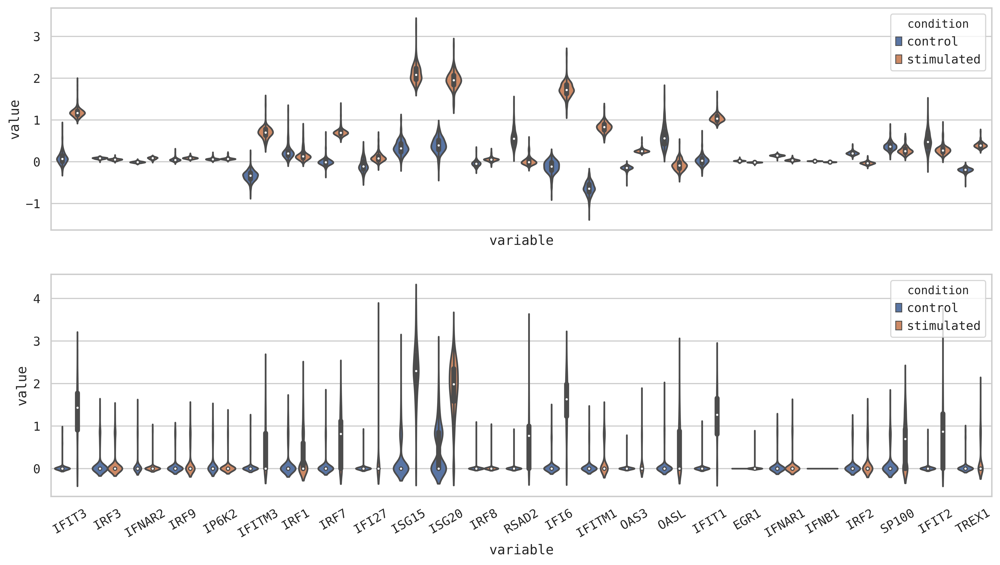

In [1032]:
_, axs = plt.subplots(dpi = 300, figsize= [15, 8] , nrows=2, sharex = True)

X = cd4rs_unstim.append(cd4rs_stim)[ list(nodes [ terms.index('GO:0071357') ]['gene2go'] & set(logo_genes.genes.values) ) ]
X[ 'condition' ] = ['control']*cd4rs_unstim.shape[0] + ['stimulated']*cd4rs_stim.shape[0]
Xm = X.melt(id_vars='condition')

sns.violinplot(y = 'value', x = 'variable', data = Xm, hue = 'condition', dodge = True, ax = axs[0])
axs[0].xaxis.set_tick_params(rotation = 30);

Xo = cd4ro_unstim.append(cd4ro_stim)[ list(nodes [ terms.index('GO:0071357') ]['gene2go'] & set(logo_genes.genes.values) ) ]
Xo[ 'condition' ] = ['control']*cd4ro_unstim.shape[0] + ['stimulated']*cd4ro_stim.shape[0]
Xom = Xo.melt(id_vars='condition')

sns.violinplot(y = 'value', x = 'variable', data = Xom, hue = 'condition', dodge = True, ax = axs[1])
axs[1].xaxis.set_tick_params(rotation = 30);

## GO-enrichment analysis

GO-terms enrichment analysis was performed with __*goenrich*__ package. Here we used GO-annotation from NCBI, but Swiss-Prot annotation gives almost the same results.  
__*goenrich*__ was taked from https://github.com/jdrudolph/goenrich/  
Usage examples can be found here: https://github.com/jdrudolph/goenrich/blob/master/examples/go_enrichment_with_goenrich.ipynb  
GO-annotation data from UniProt and NCBI can be found at ./GOann/ directory.   


In [ ]:
## GO-enrichment with python can be done using:
## 1. - goatools - https://github.com/tanghaibao/goatools
## 2. - goenrich - https://github.com/jdrudolph/goenrich/ - this one is our choice
##      -- https://github.com/jdrudolph/goenrich/blob/master/examples/go_enrichment_with_goenrich.ipynb

import goenrich
# build the ontology
O = goenrich.obo.ontology('./GOann/go-basic.obo')

# use all entrez geneid associations form gene2go as background
# use annot = goenrich.read.goa('db/gene_association.goa_human.gaf.gz') for uniprot
#sp2go   = goenrich.read.goa('GOann/goa_human.gaf.gz', False, low_memory=False) ## read swiss-prot GO annotation
gen_info = pd.read_table('GOann/Homo_sapiens.gene_info.gz', header = 0)
gene2go = goenrich.read.gene2go('GOann/gene2go.gz')

gene2go = pd.merge( gene2go, gen_info[['GeneID','Symbol']], on = 'GeneID' )

values = { k: set(v) for k,v in gene2go.groupby('GO_ID')['Symbol'] }

goenrich.enrich.propagate(O, values, 'gene2go')

query = glist
background_attribute = 'gene2go'

# for additional export to graphviz just specify the gvfile argument
# the show argument keeps the graph reasonably small
#df = goenrich.enrich.analyze(O, query, background_attribute).dropna().sort_values(by='p')
options = { 'min_category_size' : 1, 'max_category_size' : 200,
            'max_category_depth' : 10 }
# nodes: nodes dictionary from the ontology graph after background was set
# query: set of identifiers for which the p value is calculated
# background_attribute: node attribute assoc. with the background set
# M: background size, total number of genes in the data
# min_category_size: categories smaller than this number are ignored
# max_category_size: categories larger than this number are ignored
# max_category_depth: categories lower in the hierarchy (more specific) will be ignored 

## the right way to collect the genes associated with particular GO...
#nx.shortest_path_length(O, 'GO:0071357' )
terms, nodes = zip(*O.nodes(data=True))

Here we will define some functions...

In [1576]:
## ... to plot gene expression values involved in certain biological processes
def plot_exp_GO(contr, exp, GOID, main = '', wdth=15, hght=3, dpi = 150, levels = ['control', 'stimulated'], axx = False):
    gns = list( set( nodes [ terms.index(GOID) ]['gene2go'] ) & set( contr.columns.values.tolist()) )
    X = contr[gns].append(exp[gns])
    X[ 'condition' ] =  [ levels[0] ] * contr.shape[0] + [ levels[1] ] * exp.shape[0]
    Xm = X.melt(id_vars='condition')
    
    if not axx:
        plt.figure(figsize = [wdth, hght], dpi = dpi)
        ax = sns.violinplot(y = 'value', x = 'variable', data = Xm, hue = 'condition', dodge = True)
        ax.xaxis.set_tick_params(rotation = 30)
        ax.set_title(f'{GOID}, {main}')
        return ax
    else:
        sns.violinplot(y = 'value', x = 'variable', data = Xm, hue = 'condition', dodge = True, ax = axx)
        axx.xaxis.set_tick_params(rotation = 30)
        axx.set_title(f'{GOID}, {main}')

## ... preprocess gene expression data to remove negative values
## negative values can be observed in reconstructed expression data
## however from the biological point of view negative values are meaningless
def preprocess_dge(X , nonneg = True, thrsh = 0, use_abs = False):
    Xc = X.copy() ## copy data to avoid modifications in original data
    if nonneg==True and use_abs == False: ## here we can also put to zeros 
        Xc = Xc * ( Xc > thrsh )          ## the values below certain threshold
    elif use_abs == True: ## this is another option
        if Xc.min().min() < 0: ## your check if the minimal value is below zero
            msk = np.abs( Xc ) > thrsh ## mask the positions with low absolute values
        else: ## if minimal value is non-negative
            msk = 1. ## initialize the mask with all ones
        if nonneg:
            Xc = Xc - Xc.min().min() + 0.1 ## make all values nonegative
        Xc = Xc * msk ## apply the logical mask
    return Xc 
    

def analyze_DEG_GSEA( set1, set2, top = 50, genes = False, method = 'bonferroni', 
                      nonneg = True, thrsh = 0, use_abs = False ):
    set1c = set1.copy() ## to avoid any problems with modifying the original data
    set2c = set2.copy() ## I originally found some modifications and made this lines
                        ## copying to avoid the debugging
    
    ## preprocessing was finally included here
    if nonneg==True and use_abs == False:
        set1c = set1c * (set1c > thrsh )
        set2c = set2c * (set2c > thrsh )
    elif use_abs == True:
        if np.min(set1c).min() < 0:
            msk1 = np.abs( set1c ) > thrsh
        else:
            msk1 = 1.
        if np.min(set2c).min() < 0:
            msk2 = np.abs( set2c ) > thrsh 
        else:
            msk2 = 1.
        
        if nonneg:
            set1c = set1c - set1c.min().min() + 0.1
            set2c = set2c - set2c.min().min() + 0.1
        set1c = set1c * msk1
        set2c = set2c * msk2
    
    ## here picked differentially expressed genes with Welch test for unpaired samples
    ## we have also tried Mann-Whitney and found it to provide similar results
    ttest = ttest_ind( set1c ,
                       set2c , 
                       equal_var=False, 
                       nan_policy='omit' )
    ## in case if differentially expressed genes were found not
    genesl = genes
    if not genes:
        try:
            genes  = set1c.columns.values.tolist()
            genesl = genes 
        except:
            genesl = list(range(set1c.shape[1]))
    
    ## make a dataframe with statistics and adjusted p-values
    padj_te = pd.DataFrame({'stat' : ttest.statistic,
                            'padj' : mt(ttest.pvalue, method = method )[1],
                            'pval' : ttest.pvalue},
                             index= genesl).dropna(axis = 0).sort_values('pval')
    ## return only the genes with adjusted p-value < .05
    g_te_list = padj_te.index[ padj_te.padj < 0.05 ].values.tolist()
    
    ## if you forgot to provide gene names
    if not genes:
        print ('Please, provide gene names to perform GSEA')
        return ( {'ttest' : ttest, 'padj' : padj_te, 'DEG_sorted' : g_te_list } )
    
    else: ## ... and do GO-enrichment analysis if not...
        df_te = goenrich.enrich.analyze(O, g_te_list[:top],
                                        background_attribute, **options).dropna().sort_values('p')
        df_te.reset_index(drop = True, inplace = True)
        #df_te.drop(columns = 'term', inplace = True)
        df_te = df_te[[ 'term', 'q', 'p', 'x', 'n', 'M', 'N', 'name']]
        df_te.columns = ['GOID', 'P-val adj.', 'P-value', 'x', 'n', 'M', 'N', 'Term']
        #df_te.Term = df_te.Term.str.capitalize()
        return ( { 'ttest' : ttest, 'padj' : padj_te, 
                   'DEG_sorted' : g_te_list , 'GO_GSEA' : df_te } )
    

In [2075]:
## it's a good idea to collect the garbage from time to time...
gc.collect()

60

Here we will use our functions for some analysis. If we compare stimulated and unstimulated CD4 + T cells, we get the following results with the top-most GO terms associated with interferon type I pathways.

In [1569]:
#rslt = analyze_DEG_GSEA( cd4rs_stim * (cd4rs_stim > 0), cd4ro_unstim, top = 50 )
rslt = analyze_DEG_GSEA( cd4rs_unstim , cd4rs_stim, top = 100 , nonneg=True, use_abs=True, thrsh = 0.1)

In [1570]:
rslt['GO_GSEA']

,GOID,P-val adj.,P-value,x,n,M,N,Term
0,GO:0051607,0.000006,3.797983e-10,12,198,19649,100,defense response to virus
1,GO:0071357,0.004864,8.819083e-07,6,64,19649,100,cellular response to type I interferon
2,GO:0060337,0.004864,8.819083e-07,6,64,19649,100,type I interferon signaling pathway
3,GO:0034340,0.005714,1.381486e-06,6,69,19649,100,response to type I interferon
4,GO:0034341,0.102353,3.764985e-05,7,180,19649,100,response to interferon-gamma
...,...,...,...,...,...,...,...,...
16540,GO:0031011,1.000000,1.000000e+00,0,15,19649,100,Ino80 complex
16541,GO:0031013,1.000000,1.000000e+00,0,5,19649,100,troponin I binding
16542,GO:0031014,1.000000,1.000000e+00,0,4,19649,100,troponin T binding
16543,GO:0031017,1.000000,1.000000e+00,0,7,19649,100,exocrine pancreas development


### Original gene expression and expression after the style-transfer comparison

The pairs for comparisons are listed below.  
* Original(C) &mdash; original expression data in control group
* Original(S) &mdash; original expression data in IFN&beta;-stimulated group
* Transfer(C->S) &mdash; the condition was changed from "control" to "stimulated"
* Transfer(S->C) &mdash; the condition was changed from "stimulated" to "control"

In [1019]:
pairs = {'Original(C) vs. Original(S) CD4T' : [ orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ],
                                                   orig [ (validation.obs.cell_type == "CD4T") &
                                                           (validation.obs.condition == "stimulated") ] ] ,
         
         'Original(C) vs. Transfer(C->S) CD4T' : [ orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ],
                                                   recon [ (validation.obs.cell_type == "CD4T") &
                                                           (validation.obs.condition == "control") ] ] ,
         'Original(S) vs. Transfer(S->C) CD4T' : [ orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "stimulated") ],
                                                   recon [ (validation.obs.cell_type == "CD4T") &
                                                           (validation.obs.condition == "stimulated") ] ] ,
         'Original(C) vs. Transfer(S->C) CD4T' : [ orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ],
                                                   recon [ (validation.obs.cell_type == "CD4T") &
                                                           (validation.obs.condition == "stimulated") ] ] ,
         'Transfer(S->C) vs. Transfer(C->S) CD4T' : [ recon [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "stimulated") ],
                                                   recon [ (validation.obs.cell_type == "CD4T") &
                                                           (validation.obs.condition == "control") ] ] ,
         
         
         
         'Original(C) vs. Transfer(C->S) FCGR3A+Mono' : [ orig [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                          (validation.obs.condition == "control") ],
                                                   recon [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                           (validation.obs.condition == "control") ] ] ,
         'Original(S) vs. Transfer(S->C) FCGR3A+Mono' : [ orig [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                          (validation.obs.condition == "stimulated") ],
                                                   recon [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                           (validation.obs.condition == "stimulated") ] ] ,
         'Original(C) vs. Transfer(S->C) FCGR3A+Mono' : [ orig [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                          (validation.obs.condition == "control") ],
                                                   recon [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                           (validation.obs.condition == "stimulated") ] ] ,
         'Transfer(S->C) vs. Transfer(C->S) FCGR3A+Mono' : [ recon [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                          (validation.obs.condition == "stimulated") ],
                                                   recon [ (validation.obs.cell_type == "FCGR3A+Mono") &
                                                           (validation.obs.condition == "control") ] ] 
        }

In [1020]:
## Let's perform GO-analysis for all pairs
rslts = {}
for key in pairs.keys():
    rslts[key] = analyze_DEG_GSEA( pairs[key][0] , 
                                   pairs[key][1], top = 100 )

In [1021]:
gc.collect()

20

In [1486]:
## in such a way we can analyze a pair of samples
rslt = analyze_DEG_GSEA( pairs['Original(S) vs. Transfer(S->C) CD4T'][0] , 
                         pairs['Original(S) vs. Transfer(S->C) CD4T'][1], top = 100 , nonneg=True, thrsh = 0.1)

In [1488]:
(rslt['padj'].padj < 0.05).sum()

545

In [1487]:
rslt['GO_GSEA'].head(10) #.loc['GO:0060337']['name']

,GOID,P-val adj.,P-value,x,n,M,N,Term
0,GO:0051607,5.171254e-15,3.125569e-19,19,198,19649,100,defense response to virus
1,GO:0071357,4.010016e-14,7.271108e-18,13,64,19649,100,cellular response to type I interferon
2,GO:0060337,4.010016e-14,7.271108e-18,13,64,19649,100,type I interferon signaling pathway
3,GO:0034340,8.667806e-14,2.095571e-17,13,69,19649,100,response to type I interferon
4,GO:0045071,2.101510e-09,6.350890e-13,10,62,19649,100,negative regulation of viral genome replication
5,GO:1903901,5.870125e-08,2.128785e-11,10,87,19649,100,negative regulation of viral life cycle
6,GO:0045069,1.682285e-07,7.117554e-11,10,98,19649,100,regulation of viral genome replication
7,GO:0048525,2.428190e-07,1.174102e-10,10,103,19649,100,negative regulation of viral process
8,GO:0035455,1.399861e-06,7.614837e-10,6,21,19649,100,response to interferon-alpha
9,GO:1903900,6.947374e-06,4.199077e-09,10,148,19649,100,regulation of viral life cycle


In [1586]:
rslt = analyze_DEG_GSEA( pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][0] , 
                         pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][1] , top = 100, thrsh=0, nonneg = True )

In [1587]:
rslt['GO_GSEA']

,GOID,P-val adj.,P-value,x,n,M,N,Term
0,GO:0071357,0.000290,3.502457e-08,7,64,19649,100,cellular response to type I interferon
1,GO:0060337,0.000290,3.502457e-08,7,64,19649,100,type I interferon signaling pathway
2,GO:0034340,0.000329,5.958093e-08,7,69,19649,100,response to type I interferon
3,GO:0051607,0.032163,7.775898e-06,8,198,19649,100,defense response to virus
4,GO:0045069,0.035644,1.077187e-05,6,98,19649,100,regulation of viral genome replication
...,...,...,...,...,...,...,...,...
16540,GO:0031091,1.000000,1.000000e+00,0,91,19649,100,platelet alpha granule
16541,GO:0031092,1.000000,1.000000e+00,0,17,19649,100,platelet alpha granule membrane
16542,GO:0031093,1.000000,1.000000e+00,0,67,19649,100,platelet alpha granule lumen
16543,GO:0031095,1.000000,1.000000e+00,0,9,19649,100,platelet dense tubular network membrane


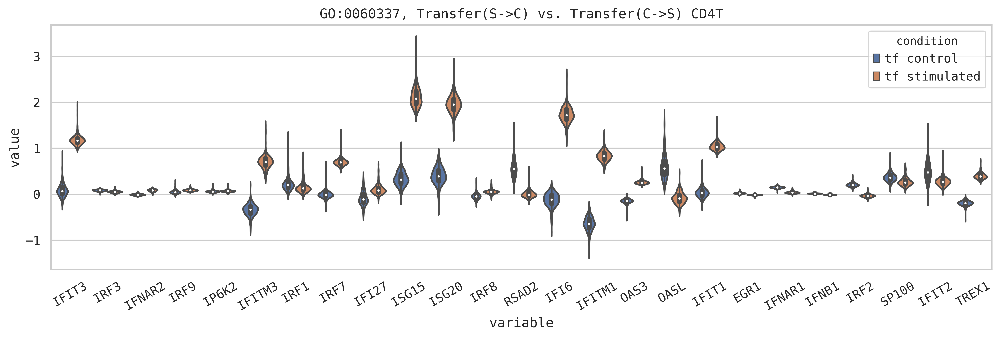

In [1053]:
## the expression of genes involved into type I interferon signaling pathway
ax = plot_exp_GO(pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][0], 
                 pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][1], 
                 'GO:0060337', main = 'Transfer(S->C) vs. Transfer(C->S) CD4T', dpi = 300, wdth = 15, hght = 4,
                 levels = ['tf control', 'tf stimulated'])

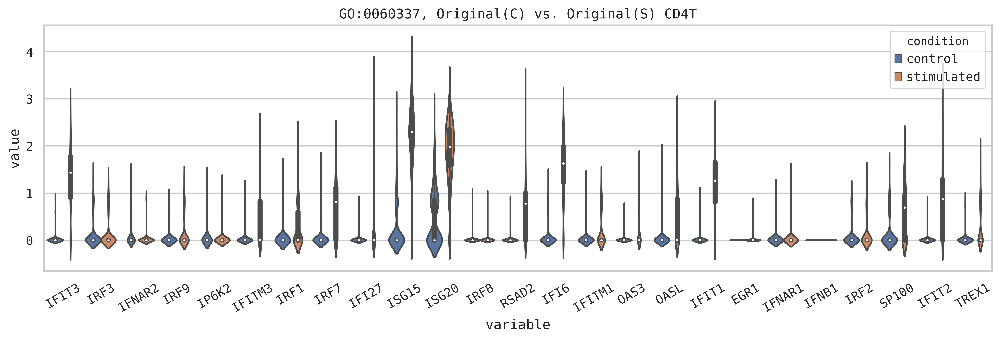

In [1035]:
## the expression of genes involved into type I interferon signaling pathway
ax = plot_exp_GO(orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "control") ], 
                 orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ], 
                 'GO:0060337', main = 'Original(C) vs. Original(S) CD4T', dpi = 300, wdth = 15, hght = 4)

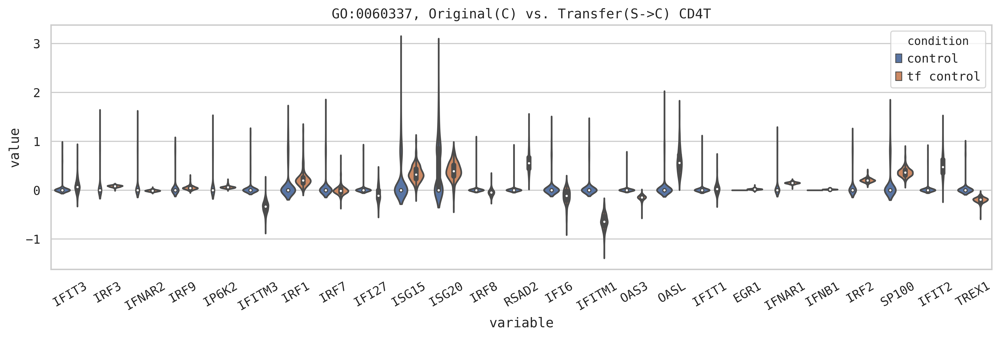

In [1051]:
## the expression of genes involved into type I interferon signaling pathway
ax = plot_exp_GO(pairs['Original(C) vs. Transfer(S->C) CD4T'][0], 
                 pairs['Original(C) vs. Transfer(S->C) CD4T'][1], 
                 'GO:0060337', main = 'Original(C) vs. Transfer(S->C) CD4T', dpi = 300, wdth = 15, hght = 4,
                 levels = ['control', 'tf control'])

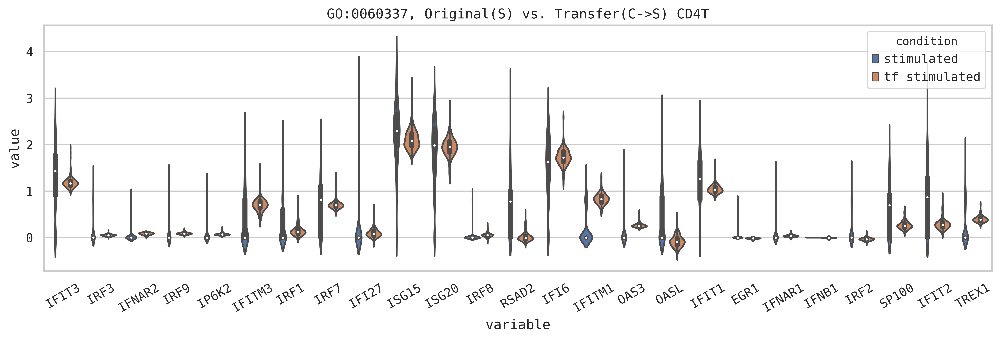

In [1054]:
## the expression of genes involved into type I interferon signaling pathway
ax = plot_exp_GO(orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ],
                 recon [ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control") ] , 
                 'GO:0060337', main = 'Original(S) vs. Transfer(C->S) CD4T', dpi = 300, wdth = 15, hght = 4, 
                 levels = ['stimulated', 'tf stimulated'] )

From the analysis shown above and from the plots we can see that autoencoder model seems to be able to catch biologically relevant gene expression changes and style transfer can provide some insights.

The code shown below was used to format dataframes and to convert formatted dataframes into pictures &mdash; sometimes this might be useful. However you will need **_imgkit_** package for that. You can get it here: https://pypi.org/project/imgkit/

In [890]:
#HTML ( 
df.head(10).reset_index(drop = True).drop(
        columns = ['rejected', 'namespace']).style.format({'q': "{:.2e}", 'p': '{:.2e}'}).hide_index()#.render() )

term,q,p,x,n,M,N,name
GO:0051607,1.62e-29,9.80e-34,26,198,19649,74,defense response to virus
GO:0071357,6.76e-22,1.23e-25,16,64,19649,74,cellular response to type I interferon
GO:0060337,6.76e-22,1.23e-25,16,64,19649,74,type I interferon signaling pathway
GO:0034340,1.96e-21,4.73e-25,16,69,19649,74,response to type I interferon
GO:0034341,5.61e-13,1.69e-16,15,180,19649,74,response to interferon-gamma
GO:0045071,1.20e-12,4.34e-16,11,62,19649,74,negative regulation of viral genome replication
GO:0045069,4.76e-12,2.01e-15,12,98,19649,74,regulation of viral genome replication
GO:1903900,2.15e-11,1.04e-14,13,148,19649,74,regulation of viral life cycle
GO:1903901,4.08e-11,2.22e-14,11,87,19649,74,negative regulation of viral life cycle
GO:0071346,4.76e-11,2.88e-14,13,160,19649,74,cellular response to interferon-gamma


In [1438]:
## https://medium.com/@andy.lane/convert-pandas-dataframes-to-images-using-imgkit-5da7e5108d55
## https://pandas.pydata.org/pandas-docs/stable/user_guide/style.html
css = """
<style type=\"text/css\">
table {
color: #333;
font-family: Helvetica, Arial, sans-serif;
font-size: 10px;
border-collapse:
collapse; 
border-spacing: 0;
zoom: 3;
}
caption {
height: 15px;
padding-left: 10px;
padding-right: 20px;
padding-top: 3px;
padding-bottom: 15px;

font-size: 12px;
/*font-weight: bold;*/
text-align: left;
}
td, th {
height: 15px;
padding-left: 10px;
padding-right: 20px;
padding-top: 3px;
padding-bottom: 3px;
}
th {
border: 1px solid #EAEAEA; /* No more visible border */
background: #EAEAEA; /* Darken header a bit */
font-weight: bold;
text-align: left;
}
td {
border-right: 1px solid #EAEAEA; /*transparent; /* No more visible border */
background: #FAFAFA;
text-align: left;
}
table tr:nth-child(odd) td{
background-color: white;
}
</style>
"""

def DataFrame_to_image(data, css, outputfile="out.png", format="png", rm = True):
    '''
    For rendering a Pandas DataFrame as an image.
    data: a pandas DataFrame
    css: a string containing rules for styling the output table. This must 
         contain both the opening an closing <style> tags.
    *outputimage: filename for saving of generated image
    *format: output format, as supported by IMGKit. Default is "png"
    '''
    fn = str(np.random.randint(100500)) + "table.html"
    
    try:
        os.remove(fn)
    except:
        None
    text_file = open(fn, "a")
    
    # write the CSS
    text_file.write(css)
    # write the HTML-ized Pandas DataFrame
    try:
        text_file.write(data.to_html())
    except:
        text_file.write(data.render())
        
    text_file.close()
    
    # See IMGKit options for full configuration,
    # e.g. cropping of final image
    imgkitoptions = { "format": format ,  "xvfb": "" , "width":2500}
    
    imgkit.from_file(fn, outputfile, options=imgkitoptions)
    if rm:
        os.remove(fn)

In [1469]:
Xs = final_exp['woCD4(S) T(C->S)'] 
Xc = final_exp['woCD4(S) T(S->C)']

rslt = analyze_DEG_GSEA( Xc * (Xc > 0.25), Xs * (Xs > 0.25), top = 100 )

In [1470]:
(rslt['padj'].padj < 0.05).sum()

431

In [1471]:
rslt['GO_GSEA']

,GOID,P-val adj.,P-value,x,n,M,N,Term
0,GO:0051607,2.207445e-19,1.334207e-23,22,198,19649,100,defense response to virus
1,GO:0071357,6.507477e-16,1.179960e-19,14,64,19649,100,cellular response to type I interferon
2,GO:0060337,6.507477e-16,1.179960e-19,14,64,19649,100,type I interferon signaling pathway
3,GO:0034340,1.544719e-15,3.734589e-19,14,69,19649,100,response to type I interferon
4,GO:0045071,2.101510e-09,6.350890e-13,10,62,19649,100,negative regulation of viral genome replication
...,...,...,...,...,...,...,...,...
16540,GO:0031125,1.000000e+00,1.000000e+00,0,9,19649,100,rRNA 3'-end processing
16541,GO:0031126,1.000000e+00,1.000000e+00,0,12,19649,100,snoRNA 3'-end processing
16542,GO:0031127,1.000000e+00,1.000000e+00,0,2,19649,100,"alpha-(1,2)-fucosyltransferase activity"
16543,GO:0031589,1.000000e+00,1.000000e+00,0,181,19649,100,cell-substrate adhesion


In [872]:
import imgkit
imgkitoptions = {"format": "png",  "xvfb": ""}

In [1449]:
DataFrame_to_image( rslt['GO_GSEA'].head(10).style.format(
    {'P-val adj.': "{:.2e}", 'P-value': '{:.2e}'}).set_caption('GO-terms enrichment analysis of DEGs in Transfer(S->C) vs. Transfer(C->S) CD4T').hide_index(),
    #{'P-val adj.': "{:.2e}", 'P-value': '{:.2e}'}).set_caption('GO-terms enrichment analysis of DEGs in O(C) vs. O(S) CD4T').hide_index(),
                   css ,  'GO_GSEA.png', rm = True)

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


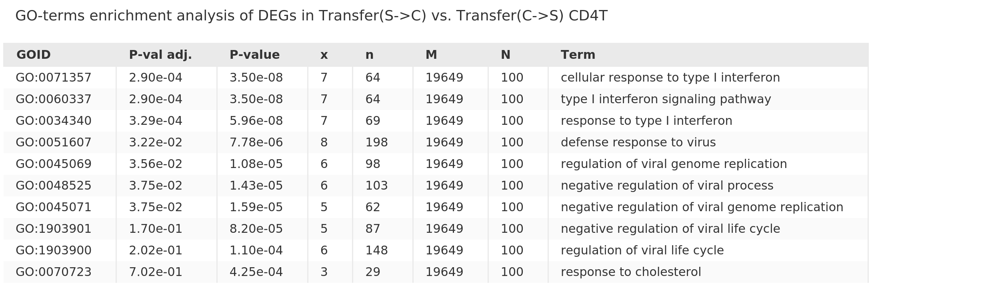

In [1450]:
Image('./GO_GSEA.png') ##

***

And now we will experiment with the results of LOGO-trained models.  
  

In [1077]:
## prepare the description
logo_obs = pd.concat([validation.obs.reset_index().reset_index()]*2, ignore_index=True).sort_values('level_0')

In [1078]:
logo_obs = pd.concat([logo_obs, stimCD4_cls.set_index(logo_obs.index)], axis=1).reset_index(drop = True)[[
    'index','condition','cell_type', 1]]

In [1079]:
logo_obs.columns = ['index','o_condition','cell_type','t_condition']
logo_obs.head()

,index,o_condition,cell_type,t_condition
0,TGCTGAGATGCTAG-1-control,control,FCGR3A+Mono,control
1,TGCTGAGATGCTAG-1-control,control,FCGR3A+Mono,stimulated
2,CAGACTGACAATCG-1-control,control,CD4T,control
3,CAGACTGACAATCG-1-control,control,CD4T,stimulated
4,GTTGGATGCTTAGG-1-control,control,FCGR3A+Mono,control


In [1103]:
gc.collect()

40

In [1106]:
## prepare the pairs
logo_pairs = {
         'Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T' : [ 
                                                   orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ][
                                                       logo_genes.genes.values],
                                                   stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                                             (logo_obs.o_condition == "control") &
                                                             (logo_obs.t_condition == "stimulated") ][
                                                       logo_genes.genes.values] ] ,
    
         'Original(C) vs. Transfer(S->C) CD4T w/o stimulated CD4T' : [ 
                                                   orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ][
                                                       logo_genes.genes.values],
                                                   stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                                             (logo_obs.o_condition == "stimulated") &
                                                             (logo_obs.t_condition == "control") ][
                                                       logo_genes.genes.values] ] ,
    
         'Original(C) vs. Transfer(C->S) CD4T w/o unstimulated CD4T' : [ 
                                                   orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ][
                                                       logo_genes.genes.values],
                                                   unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                                             (logo_obs.o_condition == "control") &
                                                             (logo_obs.t_condition == "stimulated") ][
                                                       logo_genes.genes.values] ] ,
    
         'Original(C) vs. Transfer(S->C) CD4T w/o unstimulated CD4T' : [ 
                                                   orig [ (validation.obs.cell_type == "CD4T") &
                                                          (validation.obs.condition == "control") ][
                                                       logo_genes.genes.values],
                                                   unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                                             (logo_obs.o_condition == "stimulated") &
                                                             (logo_obs.t_condition == "control") ][
                                                       logo_genes.genes.values] ] ,
         
        }

In [1107]:
## perform the DEG and GO-enrichment analysis
rslt = analyze_DEG_GSEA( logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][0] , 
                         logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][1] , top = 100 )

In [1108]:
rslt['GO_GSEA'].head(10)

,GOID,P-val adj.,P-value,x,n,M,N,Term
0,GO:0051607,6.505052e-11,3.931733e-15,16,198,19649,100,defense response to virus
1,GO:0045071,4.901352e-06,9.127709e-10,8,62,19649,100,negative regulation of viral genome replication
2,GO:0060337,4.901352e-06,1.184975e-09,8,64,19649,100,type I interferon signaling pathway
3,GO:0071357,4.901352e-06,1.184975e-09,8,64,19649,100,cellular response to type I interferon
4,GO:0034340,7.254442e-06,2.192337e-09,8,69,19649,100,response to type I interferon
5,GO:1903901,3.919270e-05,1.421313e-08,8,87,19649,100,negative regulation of viral life cycle
6,GO:0045069,8.641518e-05,3.656127e-08,8,98,19649,100,regulation of viral genome replication
7,GO:0048525,1.082294e-04,5.410018e-08,8,103,19649,100,negative regulation of viral process
8,GO:0035455,1.082294e-04,5.887366e-08,5,21,19649,100,response to interferon-alpha
9,GO:1903900,1.469789e-03,8.883583e-07,8,148,19649,100,regulation of viral life cycle


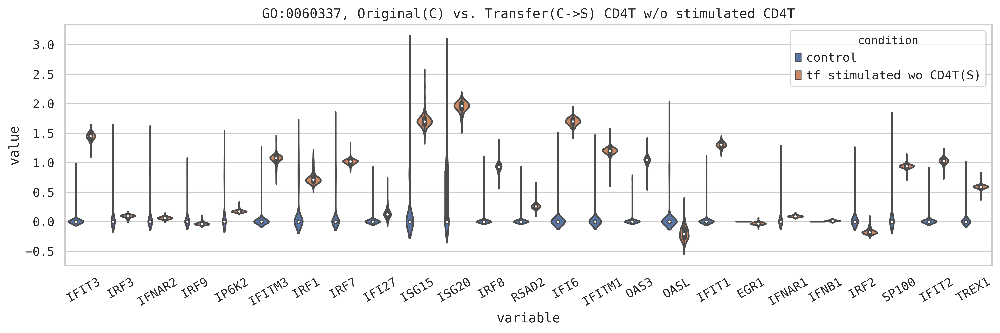

In [1252]:
## type I interferon signaling pathway
ax = plot_exp_GO(logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][0],
                 logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][1] , 
                 'GO:0060337', main = 'Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 15, hght = 4, 
                 levels = ['control', 'tf stimulated wo CD4T(S)'] )

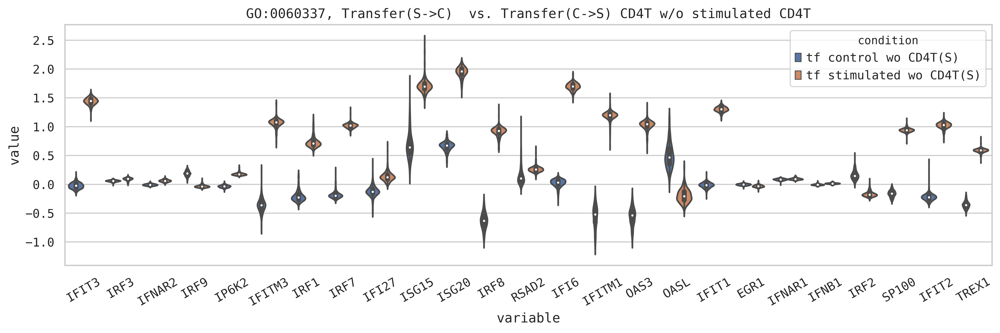

In [1114]:
ax = plot_exp_GO(stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.t_condition == "control") &
                          (logo_obs.o_condition == "stimulated") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0060337', main = 'Transfer(S->C)  vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 15, hght = 4, 
                 levels = ['tf control wo CD4T(S)', 'tf stimulated wo CD4T(S)'] )

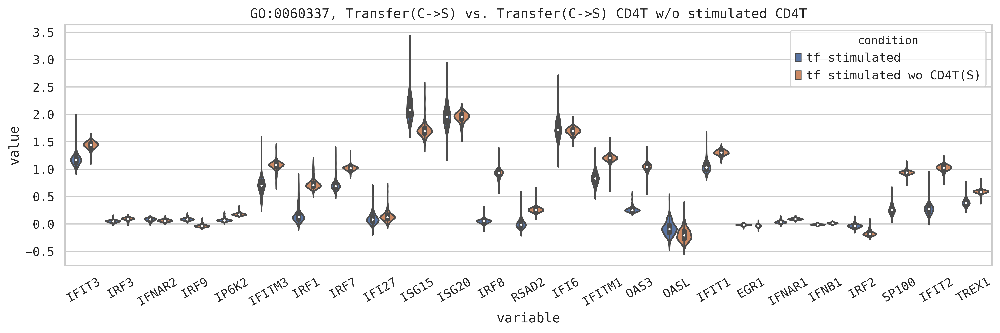

In [1113]:
ax = plot_exp_GO(recon [ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0060337', main = 'Transfer(C->S) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 15, hght = 4, 
                 levels = ['tf stimulated', 'tf stimulated wo CD4T(S)'] )

As we can see, the models trained with LOGO-approach were also able to correctly extract biologically relevant features from the expression data and were also able to make biologically-sound style-transfer.  
  
***

The code below was used to obtain the plots and the tables for the paper and supplementary materials.

In [1143]:
## and now we are ready to pick the final datasets:
final_exp = {
    'O(C)' : orig [ (validation.obs.cell_type == "CD4T") &
                    (validation.obs.condition == "control") ][logo_genes.genes.values],
    'O(S)' : orig [ (validation.obs.cell_type == "CD4T") &
                    (validation.obs.condition == "stimulated") ][logo_genes.genes.values],
    'T(C->S)' : recon [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "control") ][logo_genes.genes.values] ,
    'T(S->C)' : recon [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ][logo_genes.genes.values] ,
    
    'woCD4(S) T(C->S)' : stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                   (logo_obs.o_condition == "control") &
                                   (logo_obs.t_condition == "stimulated") ],
    'woCD4(S) T(S->C)' : stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                   (logo_obs.t_condition == "control") &
                                   (logo_obs.o_condition == "stimulated") ],
    'woCD4(S) T(C->C)' : stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                   (logo_obs.o_condition == "control") &
                                   (logo_obs.t_condition == "control") ],
    'woCD4(S) T(S->S)' : stimCD4 [ (logo_obs.cell_type == "CD4T") &
                                   (logo_obs.t_condition == "stimulated") &
                                   (logo_obs.o_condition == "stimulated") ],
    
    'woCD4(C) T(C->S)' : unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                     (logo_obs.o_condition == "control") & 
                                     (logo_obs.t_condition == "stimulated") ],
    'woCD4(C) T(S->C)' : unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                     (logo_obs.t_condition == "control") & 
                                     (logo_obs.o_condition == "stimulated") ],
    'woCD4(C) T(C->C)' : unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                     (logo_obs.o_condition == "control") & 
                                     (logo_obs.t_condition == "control") ],
    'woCD4(C) T(S->S)' : unstimCD4 [ (logo_obs.cell_type == "CD4T") &
                                     (logo_obs.t_condition == "stimulated") & 
                                     (logo_obs.o_condition == "stimulated") ]    
}

In [1117]:
gc.collect()

20

In [1120]:
keys = final_exp.keys()

In [1124]:
final_pairs_complete = list ( itertools.combinations(keys, 2) )
final_pairs_onlyO    = [ x for x in list ( itertools.combinations(keys, 2) ) if x[0][0] == 'O']

In [1125]:
final_pairs_onlyO ## the comparisons against original (O) datasets

[('O(C)', 'O(S)'),
 ('O(C)', 'T(C->S)'),
 ('O(C)', 'T(S->C)'),
 ('O(C)', 'woCD4(S) T(C->S)'),
 ('O(C)', 'woCD4(S) T(S->C)'),
 ('O(C)', 'woCD4(S) T(C->C)'),
 ('O(C)', 'woCD4(S) T(S->S)'),
 ('O(C)', 'woCD4(C) T(C->S)'),
 ('O(C)', 'woCD4(C) T(S->C)'),
 ('O(C)', 'woCD4(C) T(C->C)'),
 ('O(C)', 'woCD4(C) T(S->S)'),
 ('O(S)', 'T(C->S)'),
 ('O(S)', 'T(S->C)'),
 ('O(S)', 'woCD4(S) T(C->S)'),
 ('O(S)', 'woCD4(S) T(S->C)'),
 ('O(S)', 'woCD4(S) T(C->C)'),
 ('O(S)', 'woCD4(S) T(S->S)'),
 ('O(S)', 'woCD4(C) T(C->S)'),
 ('O(S)', 'woCD4(C) T(S->C)'),
 ('O(S)', 'woCD4(C) T(C->C)'),
 ('O(S)', 'woCD4(C) T(S->S)')]

We have also desided to apply some quantitative criteria to assess the degree of overlap between our GO-enriched groups of DEGs. The Jaccard coeeficient was our choice.   
* DEG_JI &mdash; the Jaccard coefficient between the DEGs found in current pair of datasets and DEGs observed in O vs. S
* GO10_JI &mdash; the Jaccard coefficient between the top 10 enriched GOs found in current pair and in O vs. S
* GO30_JI &mdash; the Jaccard coefficient between the top 30 enriched GOs found in current pair and in O vs. S


In [1536]:
def calc_JI(k, gt, rslts, topN):
    DEG_JI = len( set(rslts[gt]['DEG_sorted'][:topN]) & set(rslts[k]['DEG_sorted'][:topN]) 
                 )/len( set(rslts[gt]['DEG_sorted'][:topN]) | set(rslts[k]['DEG_sorted'][:topN]) )
    GO10_JI = len( set(rslts[gt]['GO_GSEA'].GOID[:10]) & set(rslts[k]['GO_GSEA'].GOID[:10]) 
                 )/len( set(rslts[gt]['GO_GSEA'].GOID[:10]) | set(rslts[k]['GO_GSEA'].GOID[:10]) )
    GO30_JI = len( set(rslts[gt]['GO_GSEA'].GOID[:30]) & set(rslts[k]['GO_GSEA'].GOID[:30]) 
                 )/len( set(rslts[gt]['GO_GSEA'].GOID[:30]) | set(rslts[k]['GO_GSEA'].GOID[:30]) )
    return ( np.array( [DEG_JI, GO10_JI, GO30_JI] ) )

def analyze_datasets(dge_sets, keys = False, topN = 100, nneg = True, gt = False, thrsh = 0, use_abs = False):
    if not keys:
        keys = dge_sets.keys()
        final_pairs_all = list ( itertools.combinations(keys, 2) )
    res_df = pd.DataFrame( index = tuple( keys ) , 
                           columns = ['N_DEGs', 'DEG_top10', 'DEG_JI', 'N_GOIDs', 'GO10_JI', 
                                      'GO30_JI', 'GO_top10', 'Terms_top10'])
    if not gt:
        gt = res_df.index.values[0]
    
    rslts ={}
    
    for k in res_df.index:
        rslt = analyze_DEG_GSEA(dge_sets[ k[0] ], dge_sets[ k[1] ], top = topN,
                                nonneg = nneg, thrsh = thrsh, use_abs = use_abs)
        res_df.loc[ k ]['N_DEGs'] = (rslt['padj'].padj < 0.01).sum()
        res_df.loc[ k ]['DEG_top10'] = '; '.join(rslt['DEG_sorted'][:10])
        res_df.loc[ k ]['N_GOIDs'] = (rslt['GO_GSEA']['P-val adj.'] < 0.05 ).sum()
        res_df.loc[ k ]['GO_top10'] = '; '.join( rslt['GO_GSEA'].GOID.values[:10] )
        res_df.loc[ k ]['Terms_top10'] = '; '.join( rslt['GO_GSEA'].Term.values[:10] )
        
        rslts[k] = rslt.copy()
    
    JIs = np.array( [ calc_JI(y, gt, rslts, topN) for y in res_df.index.values ] )
    res_df['DEG_JI']  = JIs[:,0]
    res_df['GO10_JI'] = JIs[:,1]
    res_df['GO30_JI'] = JIs[:,2]
    
    return res_df

In [1237]:
dft = analyze_datasets(final_exp, keys = final_pairs_complete [: 3] )

In [1230]:
ks = dft.index.values
topN = 100

In [1238]:
dft

N_DEGs                                          DEG_top10  \
O(C) O(S)        77  ISG15; IFI6; ISG20; IFIT3; IFIT1; IFIT2; IRF7;...   
     T(C->S)   1506  IFI6; IFIT1; IFIT3; HELZ2; PARP9; LAG3; IFITM3...   
     T(S->C)   1801  DDX51; S1PR5; RP11-879F14.1; MFSD8; ZNF700; RN...   

                DEG_JI N_GOIDs   GO10_JI   GO30_JI  \
O(C) O(S)     1.000000      29  1.000000  1.000000   
     T(C->S)  0.133333      10  0.666667  0.363636   
     T(S->C)  0.021858       0  0.052632  0.016949   

                                                       GO_top10  \
O(C) O(S)     GO:0051607; GO:0060337; GO:0071357; GO:0034340...   
     T(C->S)  GO:0060337; GO:0071357; GO:0034340; GO:0051607...   
     T(S->C)  GO:0018108; GO:0018212; GO:0051607; GO:0004713...   

                                                    Terms_top10  
O(C) O(S)     defense response to virus; type I interferon s...  
     T(C->S)  type I interferon signaling pathway; cellular ...  
     T(S->C)  peptidyl-tyrosine phosphorylation; peptidyl-ty...

From the table shown above we can see that C->S makes the C (control) samples to look more like S (stimulated) and S->C makes them look more like C. It's also important to note that the number of "differentially expressed genes" after the style transfer becomes unreasonably high. However this is expectable since autoencoder decrease the variance and expression values become less variable and become significantly different between the conditions. However we think that it is a kind of artifact and we plan to develop the models with reconstructed gene expression values following the more natural distribution.

In [1482]:
res_df = analyze_datasets(final_exp, keys = final_pairs_complete, thrsh = 0.25 )
#res_df.sort_values('DEG_JI', ascending = False, inplace = True)
res_df.to_excel('DEG_GSEA_analysis_CD4T_IFN.xlsx')

In [1585]:
res_df.head(30)

N_DEGs  \
O(C)    O(S)                 77   
        T(C->S)             847   
        T(S->C)             845   
        woCD4(S) T(C->S)    866   
        woCD4(S) T(S->C)    881   
        woCD4(S) T(C->C)    801   
        woCD4(S) T(S->S)    933   
        woCD4(C) T(C->S)    856   
        woCD4(C) T(S->C)    889   
        woCD4(C) T(C->C)    806   
        woCD4(C) T(S->S)    892   
O(S)    T(C->S)            1130   
        T(S->C)            1070   
        woCD4(S) T(C->S)   1140   
        woCD4(S) T(S->C)   1173   
        woCD4(S) T(C->C)   1120   
        woCD4(S) T(S->S)   1156   
        woCD4(C) T(C->S)   1132   
        woCD4(C) T(S->C)   1125   
        woCD4(C) T(C->C)   1122   
        woCD4(C) T(S->S)   1086   
T(C->S) T(S->C)             286   
        woCD4(S) T(C->S)    277   
        woCD4(S) T(S->C)    299   
        woCD4(S) T(C->C)    210   
        woCD4(S) T(S->S)    215   
        woCD4(C) T(C->S)    139   
        woCD4(C) T(S->C)    289   
        woCD4(C) T(C->C)    137   
        woCD4(C) T(S->S)    206   

                                                                  DEG_top10  \
O(C)    O(S)              ISG15; IFI6; ISG20; IFIT3; IFIT1; IFIT2; IRF7;...   
        T(C->S)           IFIT1; IFI6; IFIT3; HELZ2; PARP9; IFITM3; EIF2...   
        T(S->C)           TNFSF10; RSAD2; DDX58; HERC5; IFIT2; OASL; B2M...   
        woCD4(S) T(C->S)  IFIT5; LAG3; OAS3; IRF8; MS4A6A; PRF1; HELZ2; ...   
        woCD4(S) T(S->C)  CD79B; CYBB; CTSH; KIN; GLUL; OASL; ATP1B3; MA...   
        woCD4(S) T(C->C)  PDCD4; CLEC2D; RHOH; SEPT6; SOCS1; RANBP1; NCL...   
        woCD4(S) T(S->S)  IFIT1; IFIT2; IFIT3; PRF1; IFI6; IFITM3; CMPK2...   
        woCD4(C) T(C->S)  IFIT3; IFIT1; IFI6; TRIM22; HELZ2; EIF2AK2; SP...   
        woCD4(C) T(S->C)  CHPT1; HLA-DRB5; NKG7; CST7; DDX58; RSAD2; HER...   
        woCD4(C) T(C->C)  NKG7; CST7; HLA-DRB5; ATP1A1; MEAF6; CHPT1; CD...   
        woCD4(C) T(S->S)  IFIT1; IFI6; IFIT3; ISG15; IFIT2; IFITM3; IRF7...   
O(S)    T(C->S)           IFITM1; TRADD; B2M; PARP9; HELZ2; TNFSF10; RSA...   
        T(S->C)           B2M; ISG15; ISG20; IFI6; ZFP36L1; IFIT3; IFIT1...   
        woCD4(S) T(C->S)  HES4; PRF1; MS4A6A; IRF8; LAG3; WARS; IFITM1; ...   
        woCD4(S) T(S->C)  CD79B; CYBB; ISG15; IFI6; CTSH; IFIT3; IL8; IS...   
        woCD4(S) T(C->C)  ISG15; ISG20; IFI6; B2M; IFIT3; IFIT1; IFIT2; ...   
        woCD4(S) T(S->S)  PRF1; IRF8; LAG3; HES4; IFITM1; WARS; OAS3; CD...   
        woCD4(C) T(C->S)  WARS; IRF8; PRNP; PRF1; B2M; HELZ2; LAG3; IFIT...   
        woCD4(C) T(S->C)  CHPT1; HLA-DRB5; YPEL3; TMEM14C; NELFA; NKG7; ...   
        woCD4(C) T(C->C)  ISG15; ISG20; IFI6; IFIT3; B2M; IFIT1; IRF7; I...   
        woCD4(C) T(S->S)  CCDC85B; CMTM7; NDUFAF3; ATPIF1; SERPINB1; RPA...   
T(C->S) T(S->C)           ISG15; IFIT1; IFIT3; ISG20; B2M; IRF7; ZFP36L1...   
        woCD4(S) T(C->S)  HES4; PHF11; LAG3; FKBP2; CMPK2; PRF1; RBCK1; ...   
        woCD4(S) T(S->C)  ISG15; SS18L2; ATP1B3; CLEC2B; RBM3; ZFP36L1; ...   
        woCD4(S) T(C->C)  ISG15; ISG20; IFIT1; IFIT3; ENSA; IFI6; SYNE2;...   
        woCD4(S) T(S->S)  HERC5; TNFSF10; GBP4; C5orf56; RBCK1; PRF1; GB...   
        woCD4(C) T(C->S)  FKBP11; C19orf66; CMPK2; PARP9; SAMD9; PARK7; ...   
        woCD4(C) T(S->C)  IFI6; ISG15; B2M; SAMD9; ISG20; IFIT1; MZT2B; ...   
        woCD4(C) T(C->C)  ISG15; ISG20; C19orf66; IFIT1; IFI6; IFIT3; SA...   
        woCD4(C) T(S->S)  IFITM1; PARP9; FKBP11; TRADD; EIF2AK2; TRIM22;...   

                            DEG_JI N_GOIDs   GO10_JI   GO30_JI  \
O(C)    O(S)              1.000000      29  1.000000  1.000000   
        T(C->S)           0.176101      31  0.538462  0.304348   
        T(S->C)           0.206452      25  0.000000  0.111111   
        woCD4(S) T(C->S)  0.375000      16  0.818182  0.428571   
        woCD4(S) T(S->C)  0.044693       1  0.000000  0.034483   
        woCD4(S) T(C->C)  0.027473       0  0.000000  0.000000   
        woCD4(S) T(S->S)  0

In [1537]:
res_df_nneg25 = analyze_datasets(final_exp, keys = final_pairs_complete , nneg = True, use_abs=True, thrsh = 0.5)
res_df_nneg25.to_excel('DEG_GSEA_analysis_CD4T_IFN_nneg5.xlsx')

In [1539]:
res_df_nneg25.head(60) #.sort_values('DEG_JI', ascending = False)

N_DEGs  \
O(C)             O(S)                 77   
                 T(C->S)            6859   
                 T(S->C)            6811   
                 woCD4(S) T(C->S)   6852   
                 woCD4(S) T(S->C)   6847   
                 woCD4(S) T(C->C)   6892   
                 woCD4(S) T(S->S)   6907   
                 woCD4(C) T(C->S)   6722   
                 woCD4(C) T(S->C)   6804   
                 woCD4(C) T(C->C)   6764   
                 woCD4(C) T(S->S)   6848   
O(S)             T(C->S)            6868   
                 T(S->C)            6811   
                 woCD4(S) T(C->S)   6846   
                 woCD4(S) T(S->C)   6856   
                 woCD4(S) T(C->C)   6882   
                 woCD4(S) T(S->S)   6910   
                 woCD4(C) T(C->S)   6718   
                 woCD4(C) T(S->C)   6813   
                 woCD4(C) T(C->C)   6780   
                 woCD4(C) T(S->S)   6858   
T(C->S)          T(S->C)             315   
                 woCD4(S) T(C->S)    344   
                 woCD4(S) T(S->C)    329   
                 woCD4(S) T(C->C)    207   
                 woCD4(S) T(S->S)    217   
                 woCD4(C) T(C->S)    235   
                 woCD4(C) T(S->C)    325   
                 woCD4(C) T(C->C)    182   
                 woCD4(C) T(S->S)    192   
T(S->C)          woCD4(S) T(C->S)    409   
                 woCD4(S) T(S->C)    337   
                 woCD4(S) T(C->C)    315   
                 woCD4(S) T(S->S)    323   
                 woCD4(C) T(C->S)    323   
                 woCD4(C) T(S->C)    251   
                 woCD4(C) T(C->C)    264   
                 woCD4(C) T(S->S)    258   
woCD4(S) T(C->S) woCD4(S) T(S->C)    423   
                 woCD4(S) T(C->C)    340   
                 woCD4(S) T(S->S)    338   
                 woCD4(C) T(C->S)    377   
                 woCD4(C) T(S->C)    443   
                 woCD4(C) T(C->C)    349   
                 woCD4(C) T(S->S)    376   
woCD4(S) T(S->C) woCD4(S) T(C->C)    335   
                 woCD4(S) T(S->S)    325   
                 woCD4(C) T(C->S)    352   
                 woCD4(C) T(S->C)    356   
                 woCD4(C) T(C->C)    289   
                 woCD4(C) T(S->S)    337   
woCD4(S) T(C->C) woCD4(S) T(S->S)    226   
                 woCD4(C) T(C->S)    303   
                 woCD4(C) T(S->C)    355   
                 woCD4(C) T(C->C)    231   
                 woCD4(C) T(S->S)    270   
woCD4(S) T(S->S) woCD4(C) T(C->S)    293   
                 woCD4(C) T(S->C)    338   
                 woCD4(C) T(C->C)    244   
                 woCD4(C) T(S->S)    218   

                                                                           DEG_top10  \
O(C)             O(S)              ISG15; IFI6; ISG20; IFIT3; IFIT1; IFIT2; IRF7;...   
                 T(C->S)           AL627309.1; ATP13A4; OSTN-AS1; SPATA22; AC0224...   
                 T(S->C)           AL627309.1; CRIP3; DLK2; ANKEF1; RP1-302G2.5; ...   
                 woCD4(S) T(C->S)  AL627309.1; DNASE1L3; PTP4A3; RP11-755B10.2; Z...   
                 woCD4(S) T(S->C)  AL627309.1; DLK2; RP1-302G2.5; RP1-8B1.4; ENPP...   
                 woCD4(S) T(C->C)  AL627309.1; MACROD2; ANKEF1; PTK7; CRIP3; DLK2...   
                 woCD4(S) T(S->S)  AL627309.1; TMEM198; UST; RP11-316O14.1; CLC; ...   
                 woCD4(C) T(C->S)  AL627309.1; NEO1; LINC00852; RP11-1020A11.2; P...   
                 woCD4(C) T(S->C)  AL627309.1; ARL10; RP11-214K3.24; AURKA; FAM20...   
                 woCD4(C) T(C->C)  AL627309.1; TGFBR3L; HPGDS; CCSER1; MS4A4A; FA...   
                 woCD4(C) T(S->S)  AL627309.1; AC022498.1; CACNA1A; RPL39L; SPATA...   
O(S)             T(C->S)           AL627309.1; N4BP3; COL23A1; RP5-1028K7.2; TNS4...   
                 T(S->C)           AL627309.1; BPHL; HIGD1B; RP11-428J1.5; F13A1;...   
                 woCD4(S) T(C->S)  AL627309.1; FANCG; PIGO; MCF2L2; SEMA7A; PKIG;...   
                 woCD4(S) T(S

In [1302]:
rslt['GO_GSEA'][(rslt['GO_GSEA'].n > 14) & (rslt['GO_GSEA'].x > 1)].sort_values('n', ascending = True).head(30)

,GOID,P-val adj.,P-value,x,n,M,N,Term
22,GO:0033033,1.000000,0.002937,2,16,19649,100,negative regulation of myeloid cell apoptotic ...
21,GO:0044827,1.000000,0.002937,2,16,19649,100,modulation by host of viral genome replication
24,GO:0050435,1.000000,0.004590,2,20,19649,100,amyloid-beta metabolic process
26,GO:0016895,1.000000,0.005056,2,21,19649,100,"exodeoxyribonuclease activity, producing 5'-ph..."
27,GO:0004529,1.000000,0.005056,2,21,19649,100,exodeoxyribonuclease activity
25,GO:0045655,1.000000,0.005056,2,21,19649,100,regulation of monocyte differentiation
29,GO:0062009,1.000000,0.006579,2,24,19649,100,secondary palate development
30,GO:0044788,1.000000,0.008285,2,27,19649,100,modulation by host of viral process
31,GO:0008299,1.000000,0.008893,2,28,19649,100,isoprenoid biosynthetic process
34,GO:0061157,1.000000,0.009520,2,29,19649,100,mRNA destabilization


In the next cell we will make a plot showing the expression of genes, associated with type I interferon signaling pathway (GO:0060337) in CD4+ T-cells from the original and style-transferred scRNA-Seq data.

In [1289]:
fig, axs = plt.subplots( nrows= 3, ncols = 2, figsize = [21, 12] , dpi = 300, sharex = True, sharey = True)

plot_exp_GO(pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][0], 
                 pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][1], 
                 'GO:0060337', main = 'Transfer(S->C) vs. Transfer(C->S) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['tf control', 'tf stimulated'], axx = axs[0,0])

plot_exp_GO(pairs['Original(C) vs. Transfer(S->C) CD4T'][0], 
                 pairs['Original(C) vs. Transfer(S->C) CD4T'][1], 
                 'GO:0060337', main = 'Original(C) vs. Transfer(S->C) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['control', 'tf control'], axx = axs[0,1])

plot_exp_GO(orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "control") ], 
                 orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ], 
                 'GO:0060337', main = 'Original(C) vs. Original(S) CD4T', dpi = 300, wdth = 10, hght = 4, axx = axs[1,0])

plot_exp_GO(logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][0],
                 logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][1] , 
                 'GO:0060337', main = 'Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['control', 'tf stimulated wo CD4T(S)'] , axx = axs[1,1])

plot_exp_GO(recon [ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0060337', main = 'Transfer(C->S) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf stimulated', 'tf stimulated wo CD4T(S)'] , axx = axs[2,0])

plot_exp_GO(stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.t_condition == "control") &
                          (logo_obs.o_condition == "stimulated") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0060337', main = 'Transfer(S->C)  vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf control wo CD4T(S)', 'tf stimulated wo CD4T(S)'], axx = axs[2,1] );

axs[0,0].set_xlabel('');
axs[0,1].set_xlabel('');
axs[1,0].set_xlabel('');
axs[1,1].set_xlabel('');
axs[2,0].set_xlabel('Genes');
axs[2,1].set_xlabel('Genes');

axs[0,0].set_ylabel('Expression');
axs[0,1].set_ylabel('');
axs[1,0].set_ylabel('Expression');
axs[1,1].set_ylabel('');
axs[2,0].set_ylabel('Expression');
axs[2,1].set_ylabel('');

fig.suptitle('The expression of genes, associated with type I interferon \
signaling pathway (GO:0060337),\nin CD4+ T-cells from the original and style-transferred scRNA-Seq data')

plt.subplots_adjust(wspace = 0.05 , # the amount of width reserved for space between subplots,
                                   # expressed as a fraction of the average axis width
                    hspace = 0.2)  # the amount of height reserved for space between subplots,
                                   # expressed as a fraction of the average axis height

axs = axs.flat

for n, ax in enumerate(axs):
    ax.text(-0.02, 1.025, 'ABCDEFGHIJ'[n]+'.', transform=ax.transAxes, 
            size=14)#, weight='bold')

In [2076]:
gc.collect()

20

And in the cells below we will make the plots illustrating the expression of genes, associated with non-relevant GO-categories, like acetyl-CoA metabolic process (GO:0006084) in CD4+ T-cells from the original and style-transferred scRNA-Seq data

In [1303]:
fig, axs = plt.subplots( nrows= 3, ncols = 2, figsize = [21, 12] , dpi = 300, sharex = True, sharey = True)

plot_exp_GO(pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][0], 
                 pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][1], 
                 'GO:0006084', main = 'Transfer(S->C) vs. Transfer(C->S) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['tf control', 'tf stimulated'], axx = axs[0,0])

plot_exp_GO(pairs['Original(C) vs. Transfer(S->C) CD4T'][0], 
                 pairs['Original(C) vs. Transfer(S->C) CD4T'][1], 
                 'GO:0006084', main = 'Original(C) vs. Transfer(S->C) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['control', 'tf control'], axx = axs[0,1])

plot_exp_GO(orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "control") ], 
                 orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ], 
                 'GO:0006084', main = 'Original(C) vs. Original(S) CD4T', dpi = 300, wdth = 10, hght = 4, axx = axs[1,0])

plot_exp_GO(logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][0],
                 logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][1] , 
                 'GO:0006084', main = 'Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['control', 'tf stimulated wo CD4T(S)'] , axx = axs[1,1])

plot_exp_GO(recon [ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0006084', main = 'Transfer(C->S) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf stimulated', 'tf stimulated wo CD4T(S)'] , axx = axs[2,0])

plot_exp_GO(stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.t_condition == "control") &
                          (logo_obs.o_condition == "stimulated") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0006084', main = 'Transfer(S->C)  vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf control wo CD4T(S)', 'tf stimulated wo CD4T(S)'], axx = axs[2,1] );

axs[0,0].set_xlabel('');
axs[0,1].set_xlabel('');
axs[1,0].set_xlabel('');
axs[1,1].set_xlabel('');
axs[2,0].set_xlabel('Genes');
axs[2,1].set_xlabel('Genes');

axs[0,0].set_ylabel('Expression');
axs[0,1].set_ylabel('');
axs[1,0].set_ylabel('Expression');
axs[1,1].set_ylabel('');
axs[2,0].set_ylabel('Expression');
axs[2,1].set_ylabel('');

fig.suptitle('The expression of genes, associated with acetyl-CoA metabolic process \
(GO:0006084),\nin CD4+ T-cells from the original and style-transferred scRNA-Seq data')

plt.subplots_adjust(wspace = 0.05 , # the amount of width reserved for space between subplots,
                                   # expressed as a fraction of the average axis width
                    hspace = 0.2)  # the amount of height reserved for space between subplots,
                                   # expressed as a fraction of the average axis height

axs = axs.flat

for n, ax in enumerate(axs):
    ax.text(-0.02, 1.025, 'ABCDEFGHIJ'[n]+'.', transform=ax.transAxes, 
            size=14)#, weight='bold')

In [1295]:
fig, axs = plt.subplots( nrows= 3, ncols = 2, figsize = [21, 12] , dpi = 300, sharex = True, sharey = True)

plot_exp_GO(pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][0], 
                 pairs['Transfer(S->C) vs. Transfer(C->S) CD4T'][1], 
                 'GO:0050435', main = 'Transfer(S->C) vs. Transfer(C->S) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['tf control', 'tf stimulated'], axx = axs[0,0])

plot_exp_GO(pairs['Original(C) vs. Transfer(S->C) CD4T'][0], 
                 pairs['Original(C) vs. Transfer(S->C) CD4T'][1], 
                 'GO:0050435', main = 'Original(C) vs. Transfer(S->C) CD4T', dpi = 300, wdth = 10, hght = 4,
                 levels = ['control', 'tf control'], axx = axs[0,1])

plot_exp_GO(orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "control") ], 
                 orig [ (validation.obs.cell_type == "CD4T") &
                        (validation.obs.condition == "stimulated") ], 
                 'GO:0050435', main = 'Original(C) vs. Original(S) CD4T', dpi = 300, wdth = 10, hght = 4, axx = axs[1,0])

plot_exp_GO(logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][0],
                 logo_pairs['Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T'][1] , 
                 'GO:0050435', main = 'Original(C) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['control', 'tf stimulated wo CD4T(S)'] , axx = axs[1,1])

plot_exp_GO(recon [ (validation.obs.cell_type == "CD4T") &
                         (validation.obs.condition == "control") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0050435', main = 'Transfer(C->S) vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf stimulated', 'tf stimulated wo CD4T(S)'] , axx = axs[2,0])

plot_exp_GO(stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.t_condition == "control") &
                          (logo_obs.o_condition == "stimulated") ],
                 stimCD4 [ (logo_obs.cell_type == "CD4T") &
                          (logo_obs.o_condition == "control") &
                          (logo_obs.t_condition == "stimulated") ], 
                 'GO:0050435', main = 'Transfer(S->C)  vs. Transfer(C->S) CD4T w/o stimulated CD4T', 
                 dpi = 300, wdth = 10, hght = 4, 
                 levels = ['tf control wo CD4T(S)', 'tf stimulated wo CD4T(S)'], axx = axs[2,1] );

axs[0,0].set_xlabel('');
axs[0,1].set_xlabel('');
axs[1,0].set_xlabel('');
axs[1,1].set_xlabel('');
axs[2,0].set_xlabel('Genes');
axs[2,1].set_xlabel('Genes');

axs[0,0].set_ylabel('Expression');
axs[0,1].set_ylabel('');
axs[1,0].set_ylabel('Expression');
axs[1,1].set_ylabel('');
axs[2,0].set_ylabel('Expression');
axs[2,1].set_ylabel('');

fig.suptitle('The expression of genes, associated with amyloid-beta metabolic process \
(GO:0050435),\nin CD4+ T-cells from the original and style-transferred scRNA-Seq data')

plt.subplots_adjust(wspace = 0.05 , # the amount of width reserved for space between subplots,
                                   # expressed as a fraction of the average axis width
                    hspace = 0.2)  # the amount of height reserved for space between subplots,
                                   # expressed as a fraction of the average axis height

axs = axs.flat

for n, ax in enumerate(axs):
    ax.text(-0.02, 1.025, 'ABCDEFGHIJ'[n]+'.', transform=ax.transAxes, 
            size=14)#, weight='bold')

From the plots shown above we can see that in general both models tarined with all cell types and the models trained with LOGO-approach were able to catch biologically relevant patterns in the data and were able to make biologically sound style-transfer.  
***

On the plots shown below you can find the MAplots comparing stimulated and unstimulated cells with or without the style-transfer.

In [1607]:
def MAplot(X, Y, base = 10, axx = False, T = 0):
    X = X * (X > T)
    Y = Y * (Y > T)
    if base != None:
        M = np.log2( ( base** (X.mean(0)) ) ) - np.log2( (base **(Y.mean(0)))  )
        A = 0.5 * ( np.log2( (base**(X.mean(0))) ) + np.log2( (base** (Y.mean(0)) ) ))
    else:
        M = np.log2( (X.mean(0))*10 + 1  ) - np.log2( (Y.mean(0)*10 ) + 1)
        A = 0.5 * ( np.log2( (X.mean(0))*10 + 1  ) + np.log2( (Y.mean(0)*10 ) + 1) )
    if ax != False:
        sns.scatterplot(x = A, y = M, ax = axx, s = 20)
    else:
        sns.scatterplot(x = A, y = M, s = 20)

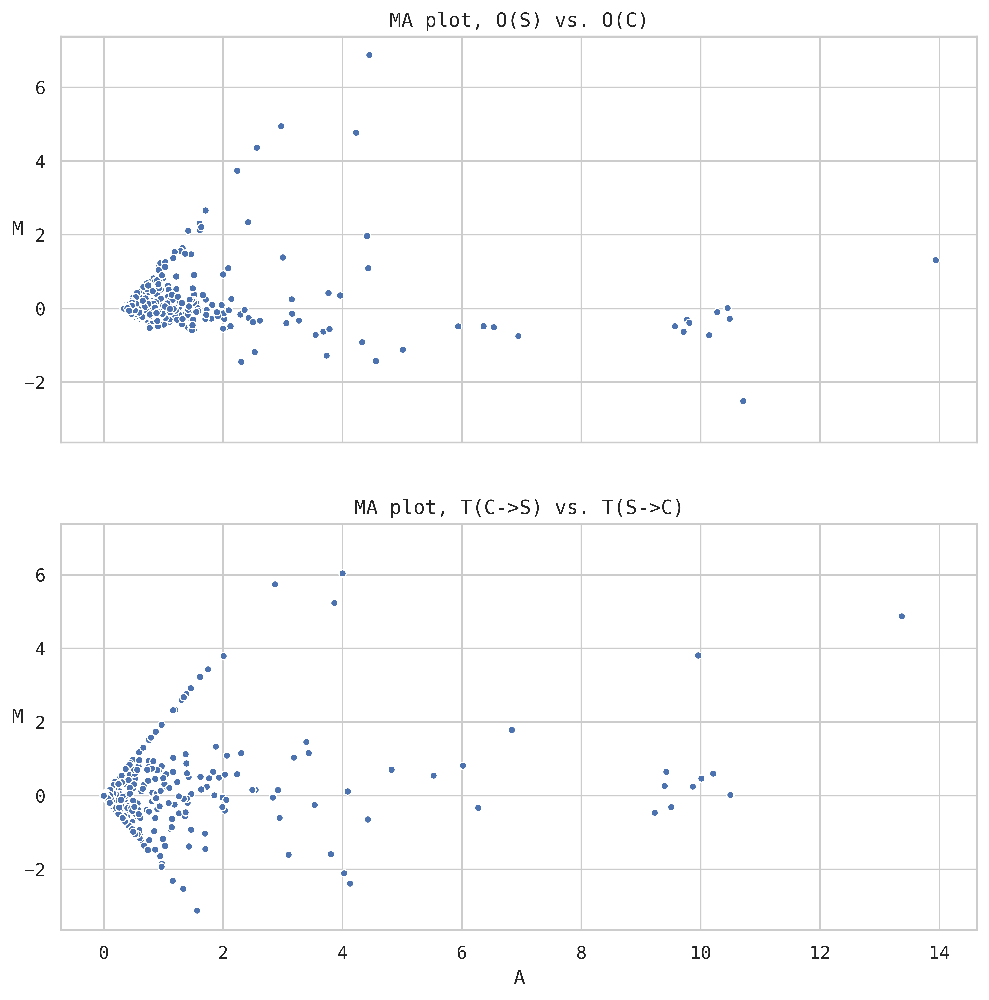

In [1608]:
_, axs = plt.subplots( figsize = [10, 10], dpi = 300, nrows = 2 , sharex = True, sharey = True)
MAplot( preprocess_dge( final_exp['O(S)'], nonneg=True, thrsh=0.25, use_abs=True),
        preprocess_dge(final_exp['O(C)'], nonneg=True, thrsh=0.25, use_abs=True) ,
        base = 10, axx = axs[0], T = 0.)
MAplot( preprocess_dge(final_exp['T(C->S)'], nonneg=True, thrsh=0.25, use_abs=False),
        preprocess_dge(final_exp['T(S->C)'], nonneg=True, thrsh=0.25, use_abs=False),
        base = 10, axx = axs[1], T = 0.)
axs[0].set_ylabel('M', rotation=0)
axs[1].set_ylabel('M', rotation=0)
axs[1].set_xlabel('A')
axs[0].set_title('MA plot, O(S) vs. O(C)')
axs[1].set_title('MA plot, T(C->S) vs. T(S->C)');

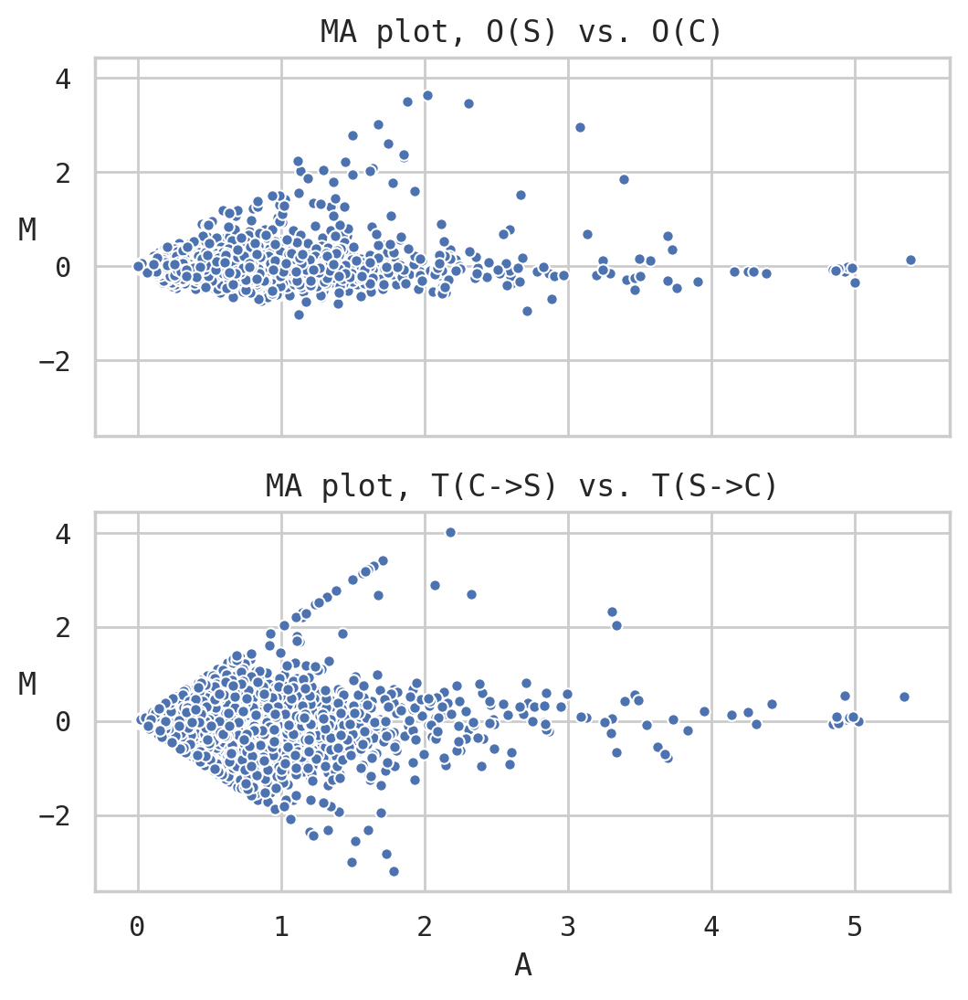

In [1459]:
_, axs = plt.subplots( figsize = [6, 6], dpi = 100, nrows = 2 , sharex = True, sharey = True)
MAplot( final_exp['O(S)'], final_exp['O(C)'] , base = None, axx = axs[0])
MAplot( final_exp['T(C->S)'], final_exp['T(S->C)'], base = None, axx = axs[1])
axs[0].set_ylabel('M', rotation=0)
axs[1].set_ylabel('M', rotation=0)
axs[1].set_xlabel('A')
axs[0].set_title('MA plot, O(S) vs. O(C)')
axs[1].set_title('MA plot, T(C->S) vs. T(S->C)');

In [1594]:
rslt = analyze_DEG_GSEA(final_exp['T(S->C)'], final_exp['O(C)'], thrsh=0, nonneg=True, top=100)

In [1595]:
DataFrame_to_image( rslt['GO_GSEA'].head(10).style.format(
    #{'P-val adj.': "{:.2e}", 'P-value': '{:.2e}'}).set_caption('GO-terms enrichment analysis of DEGs in Transfer(S->C) vs. Transfer(C->S) CD4T').hide_index(),
    {'P-val adj.': "{:.2e}", 'P-value': '{:.2e}'}).set_caption('GO-terms enrichment analysis of DEGs in O(C) vs. T(S->C) CD4+ T cells').hide_index(),
                   css ,  'GO_GSEA.png', rm = True)

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


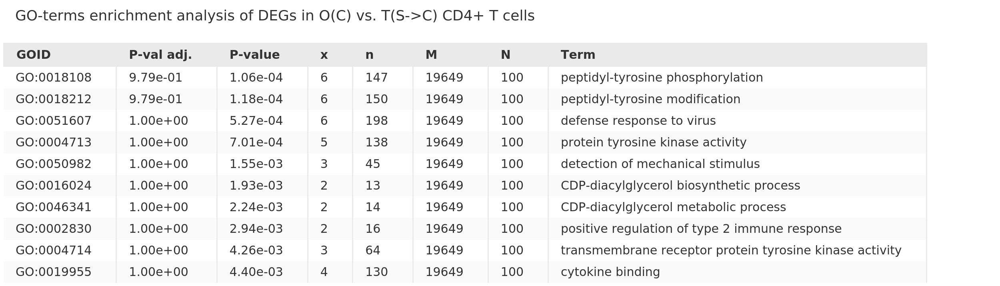

In [1596]:
Image('./GO_GSEA.png') ##

***
  
Another interesting comparison is correlation analysis of original and transferred expression in top 20-200 differentially expressed genes

In [1609]:
odegs = analyze_DEG_GSEA( final_exp['O(S)'], final_exp['O(C)'], thrsh=0, nonneg=True, top=100)

In [1610]:
tdegs = analyze_DEG_GSEA( final_exp['T(S->C)'], final_exp['T(C->S)'], thrsh=0, nonneg=True, top=100)

In [1642]:
odegs_list = odegs['padj'].index.values[ :100 ]

In [1614]:
tdegs_list = tdegs['padj'].index.values[ tdegs['padj'].padj < 0.5 ]

In [2068]:
## Pearson's and Spearman correlation between top 150 differentially expressed genes
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(C->S)'][tdegs_list[:100]].mean(0) )
pd.DataFrame( np.vstack( [final_exp['O(S)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(C->S)'][tdegs_list[:150]].mean(0)] ).T).corr().iloc[1,0], \
pd.DataFrame( np.vstack( [final_exp['O(S)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(C->S)'][tdegs_list[:150]].mean(0)] ).T).corr('spearman').iloc[1,0]

(0.9818991082501827, 0.6123726497825877)

In [2067]:
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(S->C)'][tdegs_list[:100]].mean(0) )
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(C->S)'][tdegs_list[:100]].mean(0) )
pd.DataFrame( np.vstack( [final_exp['O(S)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(S->C)'][tdegs_list[:150]].mean(0)] ).T).corr().iloc[1,0], \
pd.DataFrame( np.vstack( [final_exp['O(S)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(S->C)'][tdegs_list[:150]].mean(0)] ).T).corr('spearman').iloc[1,0]

(0.6935373550217796, 0.3236662284247053)

In [2069]:
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(S->C)'][tdegs_list[:100]].mean(0) )
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(C->S)'][tdegs_list[:100]].mean(0) )
pd.DataFrame( np.vstack( [final_exp['O(C)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(S->C)'][tdegs_list[:150]].mean(0)] ).T).corr().iloc[1,0], \
pd.DataFrame( np.vstack( [final_exp['O(C)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(S->C)'][tdegs_list[:150]].mean(0)] ).T).corr('spearman').iloc[1,0]

(0.929675049691147, 0.42255782262145913)

In [2062]:
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(S->C)'][tdegs_list[:100]].mean(0) )
#np.corrcoef( final_exp['O(S)'][tdegs_list[:100]].mean(0) , final_exp['T(C->S)'][tdegs_list[:100]].mean(0) )
pd.DataFrame( np.vstack( [final_exp['O(C)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(C->S)'][tdegs_list[:150]].mean(0)] ).T).corr().iloc[1,0], \
pd.DataFrame( np.vstack( [final_exp['O(C)'][tdegs_list[:150]].mean(0) , 
                          final_exp['T(C->S)'][tdegs_list[:150]].mean(0)] ).T).corr('spearman').iloc[1,0]

(0.7933091418996953, 0.4703662121573592)

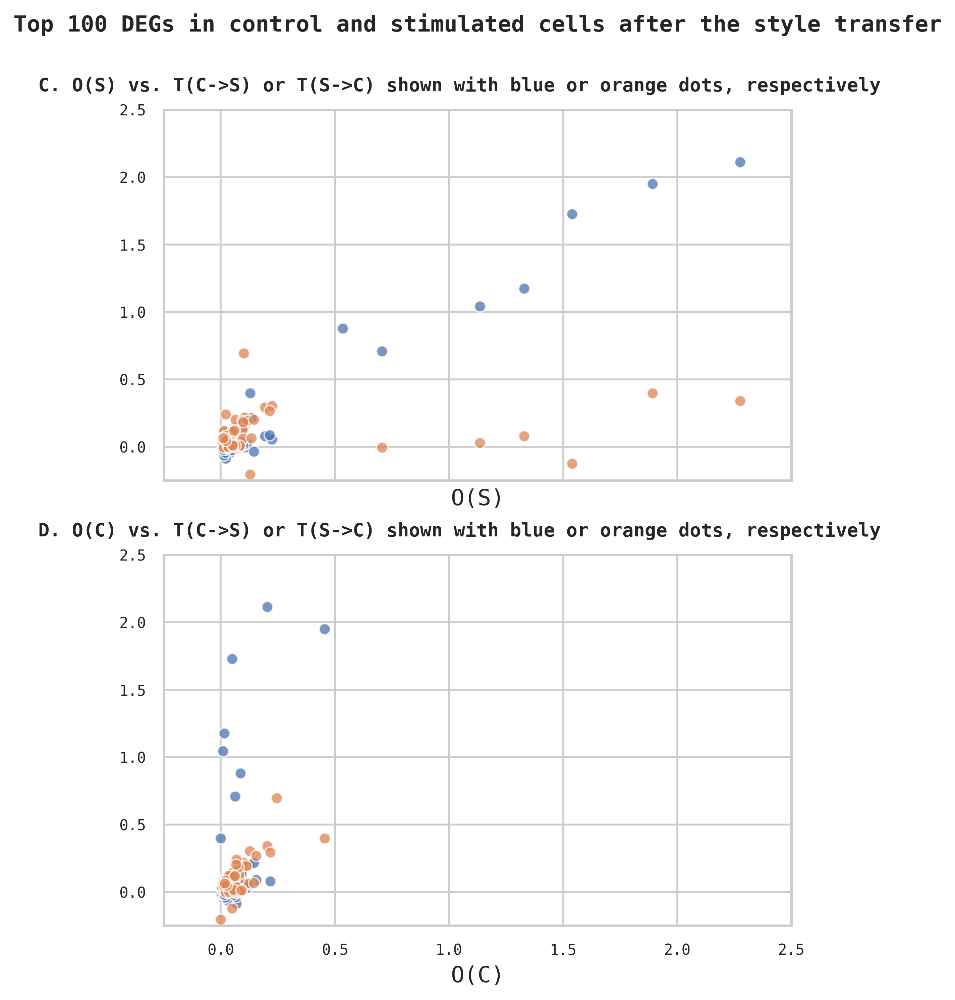

In [1743]:
_, axs = plt.subplots( figsize = [6, 8], dpi = 200, nrows = 2, sharex = True, sharey = True)
sns.scatterplot(x = final_exp['O(S)'][tdegs_list[:100]].mean(0), 
                y = final_exp['T(C->S)'][tdegs_list[:100]].mean(0), ax = axs[0], alpha = 0.75)
sns.scatterplot(x = final_exp['O(S)'][tdegs_list[:100]].mean(0), 
                y = final_exp['T(S->C)'][tdegs_list[:100]].mean(0), ax = axs[0], alpha = 0.75)

sns.scatterplot(x = final_exp['O(C)'][tdegs_list[:100]].mean(0), 
                y = final_exp['T(C->S)'][tdegs_list[:100]].mean(0), ax = axs[1], alpha = 0.75)
sns.scatterplot(x = final_exp['O(C)'][tdegs_list[:100]].mean(0), 
                y = final_exp['T(S->C)'][tdegs_list[:100]].mean(0), ax = axs[1], alpha = 0.75)
axs[1].set_ylim([-0.25, 2.5])
axs[1].set_xlim([-0.25, 2.5]);

axs[0].set_xlabel('O(S)\n')
axs[1].set_xlabel('O(C)')
axs[0].tick_params(axis='both', which='major', labelsize=8)
axs[1].tick_params(axis='both', which='major', labelsize=8)
axs[0].set_title('C. O(S) vs. T(C->S) or T(S->C) shown with blue or orange dots, respectively ', 
                 fontsize = 10, fontweight = 'bold',
                 x = - 0.2, pad = 10, horizontalalignment = 'left' );

axs[1].set_title('\n\nD. O(C) vs. T(C->S) or T(S->C) shown with blue or orange dots, respectively ', 
                 fontsize = 10,  fontweight = 'bold',
                 x = - 0.2, pad = 10, horizontalalignment = 'left' );

plt.suptitle('Top 100 DEGs in control and stimulated cells after the style transfer',
             fontsize = 12,  fontweight = 'bold', x = 0.57, y = 1.);

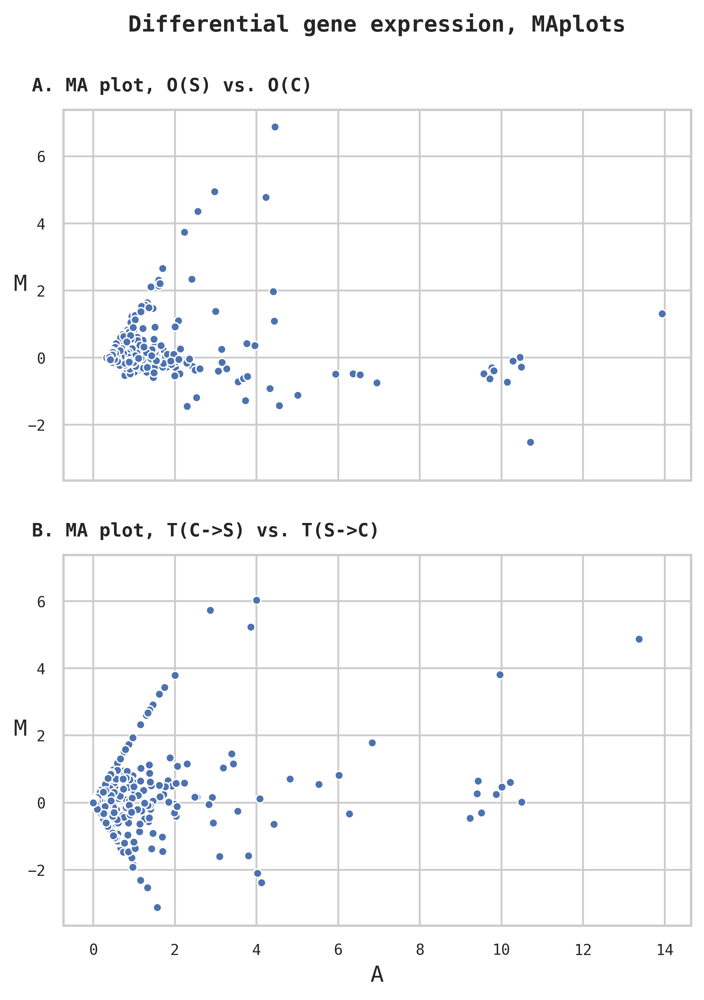

In [1748]:
_, axs = plt.subplots( figsize = [6, 8], dpi = 200, nrows = 2 , sharex = True, sharey = True)
MAplot( preprocess_dge( final_exp['O(S)'], nonneg=True, thrsh=0.25, use_abs=True),
        preprocess_dge(final_exp['O(C)'], nonneg=True, thrsh=0.25, use_abs=True) ,
        base = 10, axx = axs[0], T = 0.)
MAplot( preprocess_dge(final_exp['T(C->S)'], nonneg=True, thrsh=0.25, use_abs=False),
        preprocess_dge(final_exp['T(S->C)'], nonneg=True, thrsh=0.25, use_abs=False),
        base = 10, axx = axs[1], T = 0.)
axs[0].set_ylabel('M', rotation=0)
axs[1].set_ylabel('M', rotation=0)
axs[1].set_xlabel('A')

axs[0].tick_params(axis='both', which='major', labelsize=8)
axs[1].tick_params(axis='both', which='major', labelsize=8)
axs[0].set_title('A. MA plot, O(S) vs. O(C)', 
                 fontsize = 10, fontweight = 'bold',
                 x = - 0.05, pad = 10, horizontalalignment = 'left' );

axs[1].set_title('\n\nB. MA plot, T(C->S) vs. T(S->C)', 
                 fontsize = 10,  fontweight = 'bold',
                 x = - 0.05, pad = 10, horizontalalignment = 'left' );

plt.suptitle('Differential gene expression, MAplots',
             fontsize = 12,  fontweight = 'bold', x = 0.57, y = 1.);

***
  
Data visualizations with UMAP

In [1770]:
import umap

In [1992]:
#X = umap.UMAP(metric='cosine').fit_transform( validation.X.todense().A )
#X = umap.UMAP().fit_transform( validation.X.todense().A )
X = umap.UMAP(metric = 'minkowski', n_neighbors=10, min_dist=0.2, random_state=42).fit_transform( validation.X.todense().A )

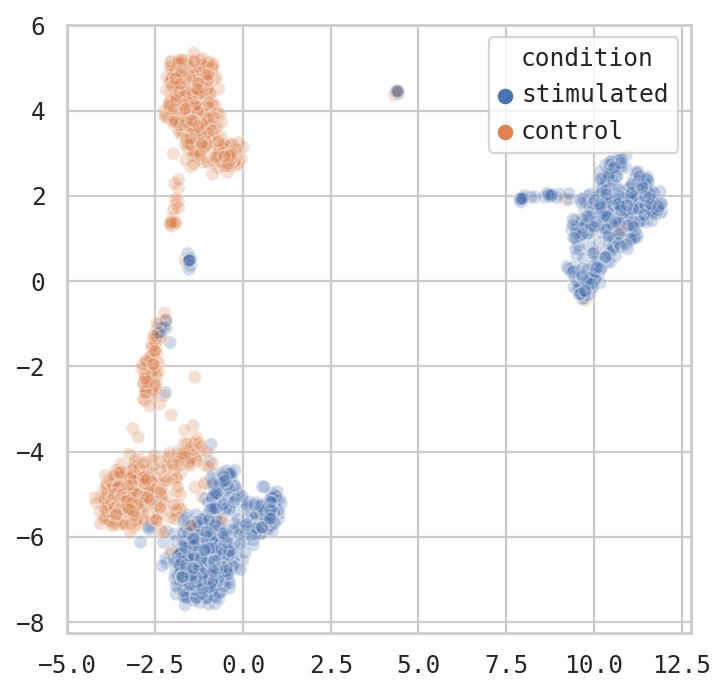

In [1993]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = X[:,0], y = X[:,1], hue = validation.obs.condition, alpha = 0.25)

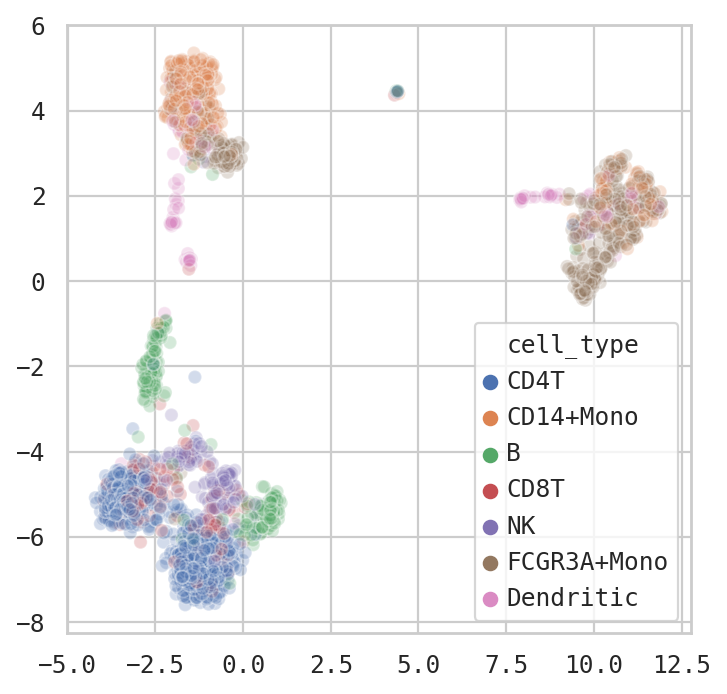

In [1994]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = X[:,0], y = X[:,1], hue = validation.obs.cell_type, alpha = 0.25)

In [1998]:
recon.shape, validation.X.shape

((1975, 6998), (1975, 6998))

In [2002]:
stimCD4.shape, logo_obs.shape

((3950, 6997), (3950, 4))

In [2003]:
unstimCD4.shape, logo_obs.shape

((3950, 6997), (3950, 4))

In [2004]:
XsCD4  = umap.UMAP(metric = 'minkowski', n_neighbors=10, min_dist=0.2, random_state=42).fit_transform( stimCD4 )
XusCD4 = umap.UMAP(metric = 'minkowski', n_neighbors=10, min_dist=0.2, random_state=42).fit_transform( unstimCD4 )

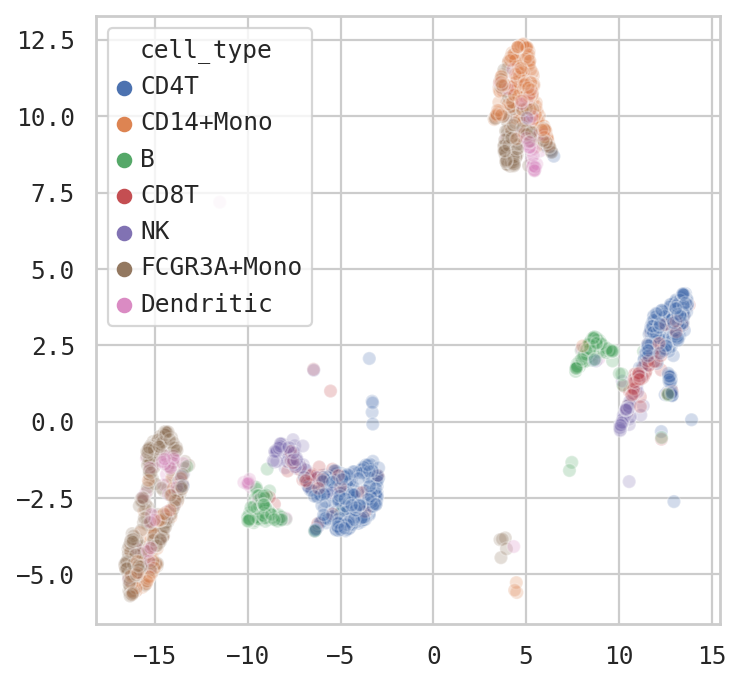

In [2029]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = XsCD4[:,0][ logo_obs.o_condition == logo_obs.t_condition],
                y = XsCD4[:,1][ logo_obs.o_condition == logo_obs.t_condition],
                hue = logo_obs.cell_type[ logo_obs.o_condition == logo_obs.t_condition], alpha = 0.25)

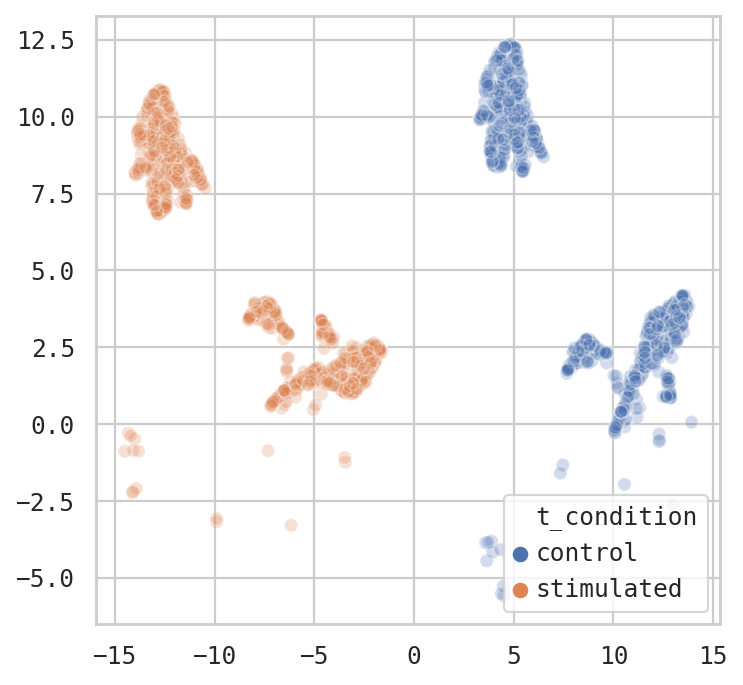

In [2033]:
plt.figure( figsize = [5, 5], dpi = 80)
choose = (logo_obs.o_condition == 'control')
sns.scatterplot(x = XsCD4[:,0][ choose ],
                y = XsCD4[:,1][ choose ],
                hue = logo_obs.t_condition[ choose ], alpha = 0.25)

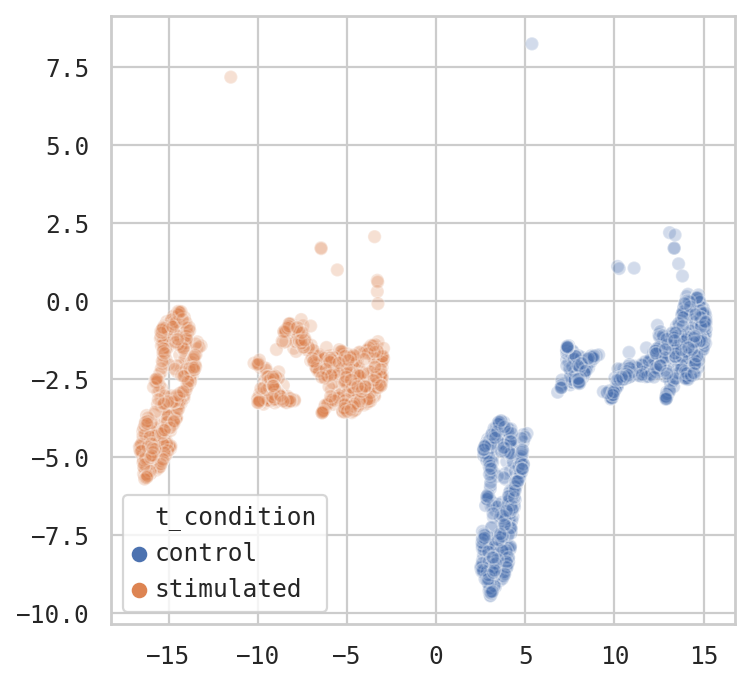

In [2041]:
plt.figure( figsize = [5, 5], dpi = 80)
choose = (logo_obs.o_condition == 'stimulated')
sns.scatterplot(x = XsCD4[:,0][ choose ],
                y = XsCD4[:,1][ choose ] ,#* -1,
                hue = logo_obs.t_condition[ choose ], alpha = 0.25)

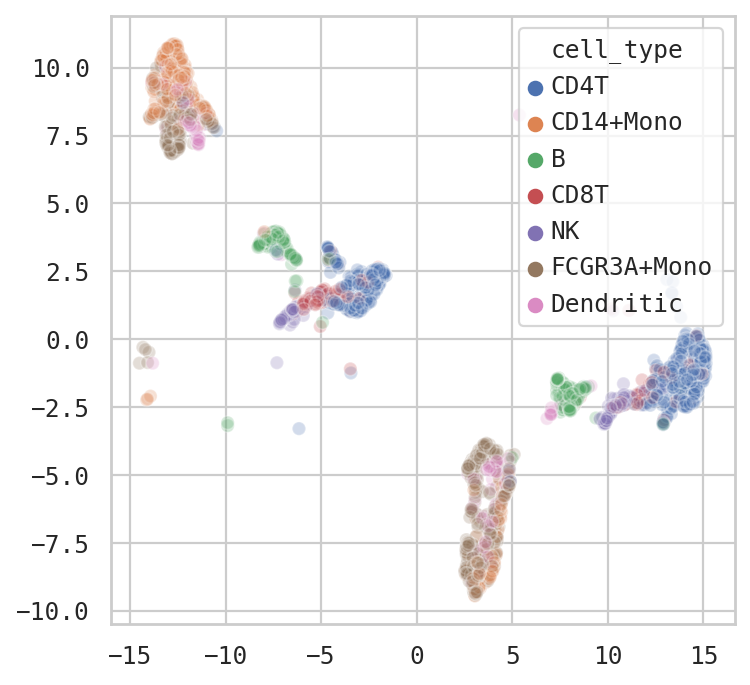

In [2030]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = XsCD4[:,0][ logo_obs.o_condition != logo_obs.t_condition],
                y = XsCD4[:,1][ logo_obs.o_condition != logo_obs.t_condition],
                hue = logo_obs.cell_type[ logo_obs.o_condition != logo_obs.t_condition], alpha = 0.25)

In [1995]:
#Xr = umap.UMAP(metric='cosine').fit_transform( recon )
Xr = umap.UMAP(metric = 'minkowski', n_neighbors=10, min_dist=0.2, random_state=42).fit_transform( recon )

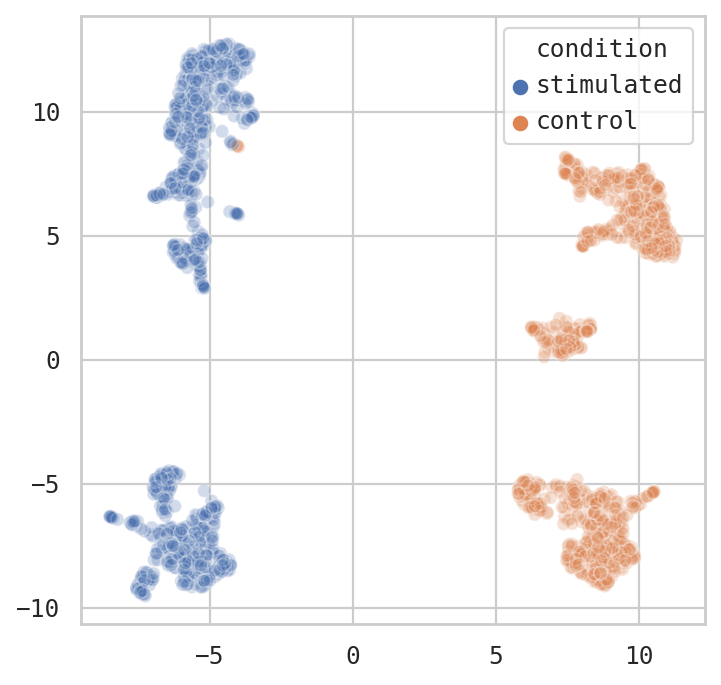

In [1996]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = Xr[:,0], y = Xr[:,1], hue = validation.obs.condition, alpha = 0.25)

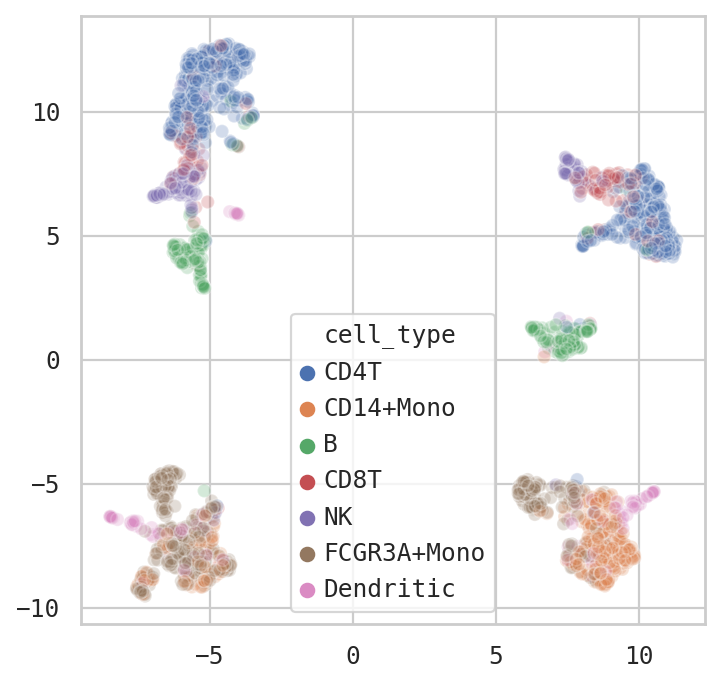

In [1997]:
plt.figure( figsize = [5, 5], dpi = 80)
sns.scatterplot(x = Xr[:,0], y = Xr[:,1], hue = validation.obs.cell_type, alpha = 0.25)

In [1837]:
#mXr = umap.UMAP(metric='cosine').fit_transform( m_rec )
#n_neighbors
m = [ ## Minkowski style metrics
    'euclidean',
    'manhattan',
    'chebyshev',
    'minkowski', #3
    ##Miscellaneous spatial metrics
    'canberra',
    'braycurtis',
    'haversine', #6
    ##Normalized spatial metrics
    'mahalanobis',
    'wminkowski',
    'seuclidean',
    ##Angular and correlation metrics
    'cosine', #10
    'correlation'] #11
#mXo = umap.UMAP(metric = m[3], n_neighbors = 30).fit_transform( m_ori[::3] )

In [1860]:
h_lat = np.load('./transfer/reconstructed/GSE96583/latents.npy')

In [1931]:
#hL = umap.UMAP().fit_transform( h_lat )
hL = umap.UMAP(metric = m[3], min_dist=.95, n_neighbors = 30).fit_transform( h_lat )

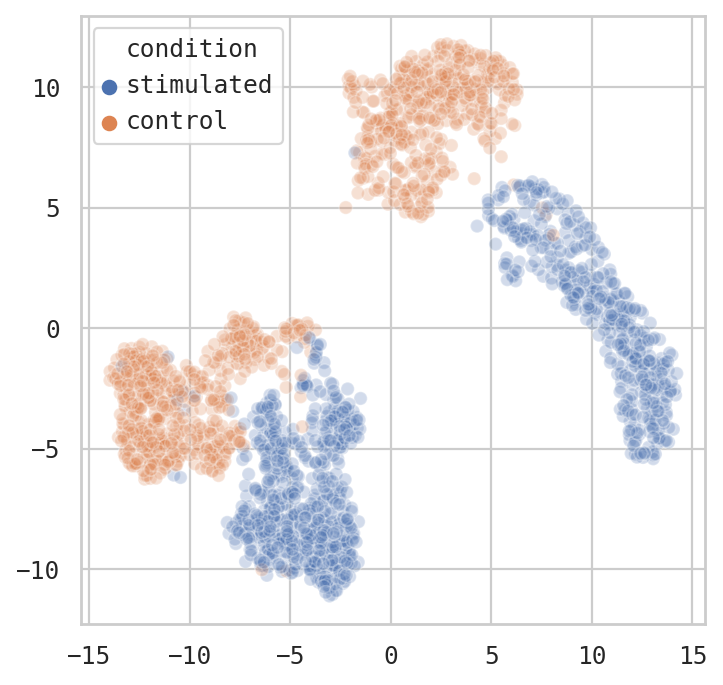

In [1932]:
plt.figure( figsize = [5, 5], dpi = 80)
#sns.scatterplot(x = mXo[:,0][::3], y = mXo[:,1][::3], hue = m_ibatch_labels.values[::3], alpha = 0.25)
#sns.scatterplot(x = mXo[:,0], y = mXo[:,1], hue = m_ibatch_labels.values[::3], alpha = 0.25)
sns.scatterplot(x = hL[:,0], y = hL[:,1], hue = validation.obs.condition, alpha = 0.25)

In [1945]:
validation.shape, hL.shape

((1975, 6998), (1975, 2))

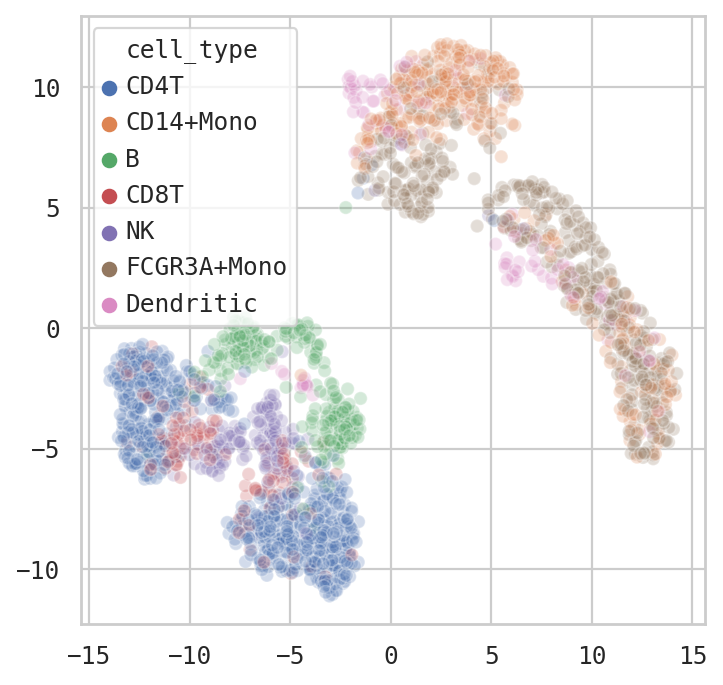

In [1933]:
plt.figure( figsize = [5, 5], dpi = 80)
#sns.scatterplot(x = mXo[:,0][::3], y = mXo[:,1][::3], hue = m_ibatch_labels.values[::3], alpha = 0.25)
#sns.scatterplot(x = mXo[:,0], y = mXo[:,1], hue = m_ibatch_labels.values[::3], alpha = 0.25)
sns.scatterplot(x = hL[:,0], y = hL[:,1], hue = validation.obs.cell_type, alpha = 0.25)